In [43]:
import numpy as np
import scanpy as sc
import pandas as pd

In [44]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.3 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.9.1 pandas==1.5.3 scikit-learn==1.2.2 statsmodels==0.13.5 python-igraph==0.10.4 pynndescent==0.5.8


Read in the AnnData file.

In [45]:
adata = sc.read_h5ad("/Volumes/NAME/deconvolution-project/filtered_MS_nuclei_hashing_gx38.h5ad")
print(adata)

AnnData object with n_obs × n_vars = 13184 × 33694
    var: 'gene_ids', 'feature_types'


Read in the metadata and the doublet and donor labels by Xichen.

In [46]:
obs = pd.read_csv(
    "/Volumes/NAME/deconvolution-project/gx38_final_result_all.csv")
obs

,Barcode,donor_identity
0,TCATGAGTCACCACAA-1,Hash454-TotalSeqA
1,ACTTATCCATTCCTCG-1,doublet
2,ATAGAGACAACAACAA-1,Hash453-TotalSeqA
3,GTAAGTCTCTTCACAT-1,Hash453-TotalSeqA
4,TCGAAGTTCAAACGTC-1,Hash456-TotalSeqA
...,...,...
13179,CCGGACACAAAGCACG-1,Hash452-TotalSeqA
13180,TCCGGGAAGAAGAGCA-1,negative
13181,TCGAAGTCAAATGAAC-1,negative
13182,CTGTACCAGAACTTCC-1,Hash455-TotalSeqA


In [47]:
obs_vario = pd.read_csv(
    "/Volumes/NAME/deconvolution-project/gx38_vireo_assignment.csv", 
    usecols=["cell", "donor_id", "classification"])
obs_vario

,cell,donor_id,classification
0,AAACCCAAGGATGAGA-1,donor0,singlet
1,AAACCCAAGGTACCTT-1,unassigned,unassigned
2,AAACCCAAGTCATTGC-1,donor0,singlet
3,AAACCCAAGTTGGAGC-1,donor3,singlet
4,AAACCCACAAGGCTTT-1,donor3,singlet
...,...,...,...
13179,TTTGTTGTCCACTTTA-1,donor3,singlet
13180,TTTGTTGTCCCTCTAG-1,donor1,singlet
13181,TTTGTTGTCCGTACGG-1,donor5,singlet
13182,TTTGTTGTCGCTTGAA-1,donor5,singlet


In [48]:
obs_meta_sel = pd.read_csv(
    "/Volumes/NAME/deconvolution-project/adataobs_MSmultiplex_DendrouSchirmerJakel_integrated.csv", 
    usecols=["cluster_label", "lowres_cluster_label", "sample_id", "batch"])
obs_meta_sel.head()

,sample_id,batch,cluster_label,lowres_cluster_label
0,704193_GX53,0,ProtoAstro_SLC1A2hi_NRXN1hi,ProtoAstro
1,704193_GX53,0,FibrousAstro-CD44hi_S100Bpos_FOShi_VIMpos,FibrousAstro
2,704193_GX53,0,FibrousAstro-CD44hi_S100Bpos_FOShi_VIMpos,FibrousAstro
3,704193_GX53,0,PhagoProtoAstro_MERTKhi_MEGF10hi,ProtoAstro
4,704193_GX53,0,PhagoProtoAstro_MERTKhi_MEGF10hi,ProtoAstro


In [49]:
obs_meta_all = pd.read_csv("/Volumes/NAME/deconvolution-project/adataobs_MSmultiplex_DendrouSchirmerJakel_integrated.csv", index_col=0, low_memory=False)
obs_meta_all.head()

,sample_id,batch,antibody,library_id,patient,block_position,demult_sample_id,disorder,disease_type,age,...,tissue,library,brain_region,leiden_res_0.1,leiden_res_0.3,leiden_res_0.5,leiden_res_1,cluster_label,lowres_cluster_label,bucket
AAACGCTTCGTAGGAG-1-704193_GX53-dendrou,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,43.0,...,NaN,NaN,NaN,2,2,2,1,ProtoAstro_SLC1A2hi_NRXN1hi,ProtoAstro,astrocytes
AAAGGATTCATGCGGC-1-704193_GX53-dendrou,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,43.0,...,NaN,NaN,NaN,2,2,2,1,FibrousAstro-CD44hi_S100Bpos_FOShi_VIMpos,FibrousAstro,astrocytes
AAAGGATTCGCTTAAG-1-704193_GX53-dendrou,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,43.0,...,NaN,NaN,NaN,2,2,2,1,FibrousAstro-CD44hi_S100Bpos_FOShi_VIMpos,FibrousAstro,astrocytes
AAAGGTAAGGCCTTCG-1-704193_GX53-dendrou,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,43.0,...,NaN,NaN,NaN,2,2,2,1,PhagoProtoAstro_MERTKhi_MEGF10hi,ProtoAstro,astrocytes
AACAAAGTCCGATAAC-1-704193_GX53-dendrou,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,43.0,...,NaN,NaN,NaN,2,2,2,1,PhagoProtoAstro_MERTKhi_MEGF10hi,ProtoAstro,astrocytes


Set Index of metadata as a column. Cut all information after barcode.

In [50]:
obs_meta_all.reset_index(inplace=True)
obs_meta_all['index'] = obs_meta_all['index'].str[:18]
obs_meta_all.head()

,index,sample_id,batch,antibody,library_id,patient,block_position,demult_sample_id,disorder,disease_type,...,tissue,library,brain_region,leiden_res_0.1,leiden_res_0.3,leiden_res_0.5,leiden_res_1,cluster_label,lowres_cluster_label,bucket
0,AAACGCTTCGTAGGAG-1,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,...,NaN,NaN,NaN,2,2,2,1,ProtoAstro_SLC1A2hi_NRXN1hi,ProtoAstro,astrocytes
1,AAAGGATTCATGCGGC-1,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,...,NaN,NaN,NaN,2,2,2,1,FibrousAstro-CD44hi_S100Bpos_FOShi_VIMpos,FibrousAstro,astrocytes
2,AAAGGATTCGCTTAAG-1,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,...,NaN,NaN,NaN,2,2,2,1,FibrousAstro-CD44hi_S100Bpos_FOShi_VIMpos,FibrousAstro,astrocytes
3,AAAGGTAAGGCCTTCG-1,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,...,NaN,NaN,NaN,2,2,2,1,PhagoProtoAstro_MERTKhi_MEGF10hi,ProtoAstro,astrocytes
4,AACAAAGTCCGATAAC-1,704193_GX53,0,NaN,704193_GX53,MS352,NaN,704193_GX53_0,ms,SP,...,NaN,NaN,NaN,2,2,2,1,PhagoProtoAstro_MERTKhi_MEGF10hi,ProtoAstro,astrocytes


Filter by gx38 in sample_id (not case-sensitive).

In [51]:
obs_meta_all_gx38 = obs_meta_all[obs_meta_all['sample_id'].str.contains('gx38', case=False)]
obs_meta_all_gx38

,index,sample_id,batch,antibody,library_id,patient,block_position,demult_sample_id,disorder,disease_type,...,tissue,library,brain_region,leiden_res_0.1,leiden_res_0.3,leiden_res_0.5,leiden_res_1,cluster_label,lowres_cluster_label,bucket
606,AAACCCAGTATTTCGG-1,761433_GX38,2,Hash451,761433_GX38,C028_d,P1C2,761433_GX38_1,control,none,...,NaN,NaN,NaN,2,2,2,1,FibrousAstro-CD44hi_S100Bpos_FOShi_VIMpos,FibrousAstro,astrocytes
607,AAACGAAAGGACTGGT-1,761433_GX38,2,Hash456,761433_GX38,MS371_d,A3E4,761433_GX38_6,ms,SP,...,NaN,NaN,NaN,2,2,2,1,ProtoAstro_SLC1A2hi_NRXN1hi,ProtoAstro,astrocytes
608,AAACGAACAGTGGGTA-1,761433_GX38,2,Hash455,761433_GX38,C064,A2D1,761433_GX38_5,control,none,...,NaN,NaN,NaN,2,2,2,1,ProtoAstro_SLC1A2hi_NRXN1hi,ProtoAstro,astrocytes
609,AAACGAATCCGCACTT-1,761433_GX38,2,Hash454,761433_GX38,MS438,P2D4,761433_GX38_4,ms,Undetermined,...,NaN,NaN,NaN,2,2,2,1,PhagoProtoAstro_MERTKhi_MEGF10hi,ProtoAstro,astrocytes
610,AAACGCTAGAAGGATG-1,761433_GX38,2,Hash453,761433_GX38,MS402,A6D4,761433_GX38_3,ms,SP,...,NaN,NaN,NaN,2,2,2,1,ProtoAstro_SLC1A2hi_NRXN1hi,ProtoAstro,astrocytes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47434,TTTGGAGAGCCGTTAT-1,761433_GX38,2,Hash455,761433_GX38,C064,A2D1,761433_GX38_5,control,none,...,NaN,NaN,NaN,6,4,4,12,SST,SST,neurons
47435,TTTGGAGGTGGTACAG-1,761433_GX38,2,Hash453,761433_GX38,MS402,A6D4,761433_GX38_3,ms,SP,...,NaN,NaN,NaN,3,6,10,10,RORB_ARSJhi,RORB,neurons
47436,TTTGGTTTCCCGAACG-1,761433_GX38,2,Hash454,761433_GX38,MS438,P2D4,761433_GX38_4,ms,Undetermined,...,NaN,NaN,NaN,3,6,10,10,RORB_ARSJhi,RORB,neurons
47437,TTTGGTTTCTTGGTGA-1,761433_GX38,2,Hash453,761433_GX38,MS402,A6D4,761433_GX38_3,ms,SP,...,NaN,NaN,NaN,5,7,6,6,VIP_ABI3BP,VIP,neurons


Merge Xichen's vireo data with the new data to get the correct order.

In [52]:
obs_ordered = pd.merge(obs_vario, obs, left_on='cell', right_on='Barcode', how='outer')
obs_ordered

,cell,donor_id,classification,Barcode,donor_identity
0,AAACCCAAGGATGAGA-1,donor0,singlet,AAACCCAAGGATGAGA-1,Hash454-TotalSeqA
1,AAACCCAAGGTACCTT-1,unassigned,unassigned,AAACCCAAGGTACCTT-1,negative
2,AAACCCAAGTCATTGC-1,donor0,singlet,AAACCCAAGTCATTGC-1,Hash454-TotalSeqA
3,AAACCCAAGTTGGAGC-1,donor3,singlet,AAACCCAAGTTGGAGC-1,Hash453-TotalSeqA
4,AAACCCACAAGGCTTT-1,donor3,singlet,AAACCCACAAGGCTTT-1,Hash453-TotalSeqA
...,...,...,...,...,...
13179,TTTGTTGTCCACTTTA-1,donor3,singlet,TTTGTTGTCCACTTTA-1,Hash453-TotalSeqA
13180,TTTGTTGTCCCTCTAG-1,donor1,singlet,TTTGTTGTCCCTCTAG-1,Hash455-TotalSeqA
13181,TTTGTTGTCCGTACGG-1,donor5,singlet,TTTGTTGTCCGTACGG-1,Hash456-TotalSeqA
13182,TTTGTTGTCGCTTGAA-1,donor5,singlet,TTTGTTGTCGCTTGAA-1,Hash456-TotalSeqA


Merge Xichens obs information and the metadata for gx38. Not all cells have a match in the gx38. Here NaN is put in for those columns.

In [53]:
merged_obs = pd.merge(obs_ordered, obs_meta_all_gx38, left_on='cell', right_on='index', how='outer')
merged_obs

,cell,donor_id,classification,Barcode,donor_identity,index,sample_id,batch,antibody,library_id,...,tissue,library,brain_region,leiden_res_0.1,leiden_res_0.3,leiden_res_0.5,leiden_res_1,cluster_label,lowres_cluster_label,bucket
0,AAACCCAAGGATGAGA-1,donor0,singlet,AAACCCAAGGATGAGA-1,Hash454-TotalSeqA,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,AAACCCAAGGTACCTT-1,unassigned,unassigned,AAACCCAAGGTACCTT-1,negative,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,AAACCCAAGTCATTGC-1,donor0,singlet,AAACCCAAGTCATTGC-1,Hash454-TotalSeqA,AAACCCAAGTCATTGC-1,761433_GX38,2,Hash454,761433_GX38,...,NaN,NaN,NaN,0.0,0.0,0.0,0.0,OG - OPALINlow_SLC5A11low_RBFOXlow,OG - OPALINlow_SLC5A11low_RBFOXlow,oligodendrocytes
3,AAACCCAAGTTGGAGC-1,donor3,singlet,AAACCCAAGTTGGAGC-1,Hash453-TotalSeqA,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AAACCCACAAGGCTTT-1,donor3,singlet,AAACCCACAAGGCTTT-1,Hash453-TotalSeqA,AAACCCACAAGGCTTT-1,761433_GX38,2,Hash453,761433_GX38,...,NaN,NaN,NaN,8.0,8.0,7.0,7.0,SmoothMusc-ACTA2hi_CNN1pos,Endo,endothelial
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13179,TTTGTTGTCCACTTTA-1,donor3,singlet,TTTGTTGTCCACTTTA-1,Hash453-TotalSeqA,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13180,TTTGTTGTCCCTCTAG-1,donor1,singlet,TTTGTTGTCCCTCTAG-1,Hash455-TotalSeqA,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13181,TTTGTTGTCCGTACGG-1,donor5,singlet,TTTGTTGTCCGTACGG-1,Hash456-TotalSeqA,TTTGTTGTCCGTACGG-1,761433_GX38,2,Hash456,761433_GX38,...,NaN,NaN,NaN,0.0,0.0,0.0,3.0,OG - OPALINhi_PLXDC2hi,OG - OPALINhi_PLXDC2hi,oligodendrocytes
13182,TTTGTTGTCGCTTGAA-1,donor5,singlet,TTTGTTGTCGCTTGAA-1,Hash456-TotalSeqA,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Changing names of some columns to paper_X to not interfere with later column generation.

In [54]:
merged_obs = merged_obs.rename(columns={'doublet_scores' : 'paper_doublet_scores', 'predicted_doublets': 'paper_predicted_doublets'})

Adding only a few selected columns to not interfere with later doubled column labeling by further analysis.

In [55]:
merged_obs_sel = merged_obs.loc[:, ["Barcode", "donor_identity", "donor_id", "cluster_label", "lowres_cluster_label", "sample_id", "bucket", "disorder", "paper_doublet_scores", "paper_predicted_doublets"]]
merged_obs_sel.set_index('Barcode', inplace=True)
merged_obs_sel

,donor_identity,donor_id,cluster_label,lowres_cluster_label,sample_id,bucket,disorder,paper_doublet_scores,paper_predicted_doublets
Barcode,,,,,,,,,
AAACCCAAGGATGAGA-1,Hash454-TotalSeqA,donor0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AAACCCAAGGTACCTT-1,negative,unassigned,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AAACCCAAGTCATTGC-1,Hash454-TotalSeqA,donor0,OG - OPALINlow_SLC5A11low_RBFOXlow,OG - OPALINlow_SLC5A11low_RBFOXlow,761433_GX38,oligodendrocytes,ms,0.152860,False
AAACCCAAGTTGGAGC-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AAACCCACAAGGCTTT-1,Hash453-TotalSeqA,donor3,SmoothMusc-ACTA2hi_CNN1pos,Endo,761433_GX38,endothelial,ms,0.090532,False
...,...,...,...,...,...,...,...,...,...
TTTGTTGTCCACTTTA-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TTTGTTGTCCCTCTAG-1,Hash455-TotalSeqA,donor1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TTTGTTGTCCGTACGG-1,Hash456-TotalSeqA,donor5,OG - OPALINhi_PLXDC2hi,OG - OPALINhi_PLXDC2hi,761433_GX38,oligodendrocytes,ms,0.033449,False


In [56]:
adata.obs = merged_obs_sel
adata.obs.head()

,donor_identity,donor_id,cluster_label,lowres_cluster_label,sample_id,bucket,disorder,paper_doublet_scores,paper_predicted_doublets
Barcode,,,,,,,,,
AAACCCAAGGATGAGA-1,Hash454-TotalSeqA,donor0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AAACCCAAGGTACCTT-1,negative,unassigned,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AAACCCAAGTCATTGC-1,Hash454-TotalSeqA,donor0,OG - OPALINlow_SLC5A11low_RBFOXlow,OG - OPALINlow_SLC5A11low_RBFOXlow,761433_GX38,oligodendrocytes,ms,0.152860,False
AAACCCAAGTTGGAGC-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AAACCCACAAGGCTTT-1,Hash453-TotalSeqA,donor3,SmoothMusc-ACTA2hi_CNN1pos,Endo,761433_GX38,endothelial,ms,0.090532,False


In [57]:
adata

AnnData object with n_obs × n_vars = 13184 × 33694
    obs: 'donor_identity', 'donor_id', 'cluster_label', 'lowres_cluster_label', 'sample_id', 'bucket', 'disorder', 'paper_doublet_scores', 'paper_predicted_doublets'
    var: 'gene_ids', 'feature_types'

In [58]:
adata.var_names_make_unique()

In [59]:
adata.shape

(13184, 33694)

Doublet score generation via scrublet.

In [60]:
import scrublet as scr
scrub = scr.Scrublet(adata.X)
doublet_scores, predicted_doublets = scrub.scrub_doublets()

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.74
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 0.0%
Elapsed time: 27.5 seconds


In [61]:
print(doublet_scores)

[0.16957606 0.04362416 0.21621622 ... 0.05807275 0.03723125 0.08262548]


In [62]:
adata.obs['doublet_score'] = doublet_scores

Start of filtering and QC.

normalizing counts per cell
    finished (0:00:00)


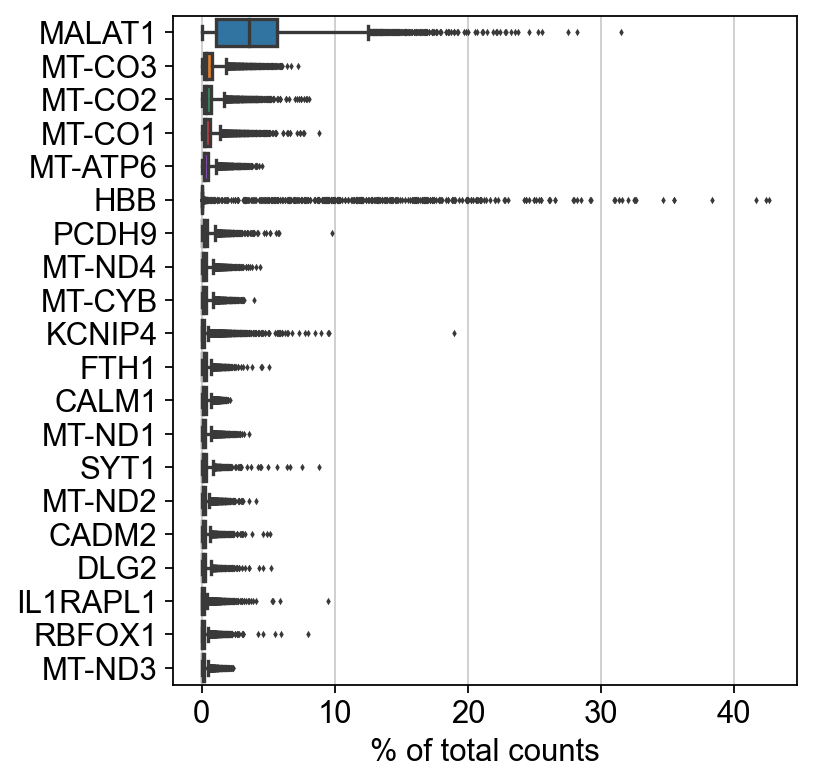

In [63]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [64]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 4 cells that have less than 200 genes expressed
filtered out 6734 genes that are detected in less than 3 cells


In [65]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

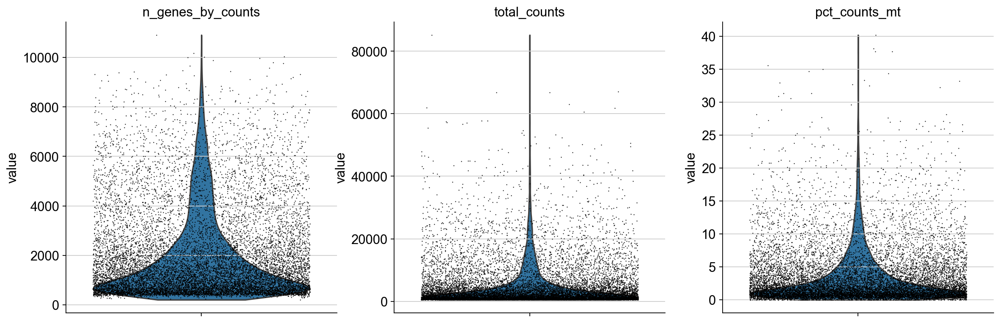

In [66]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

Check for the probable cutoff used in the dataset by the previous MS analysis. (10%, supported by their methods section)

In [67]:
print(obs_meta_all_gx38["pct_counts_mt"].max())
print(obs_meta_all_gx38["n_genes_by_counts"].max())

9.975669
9034


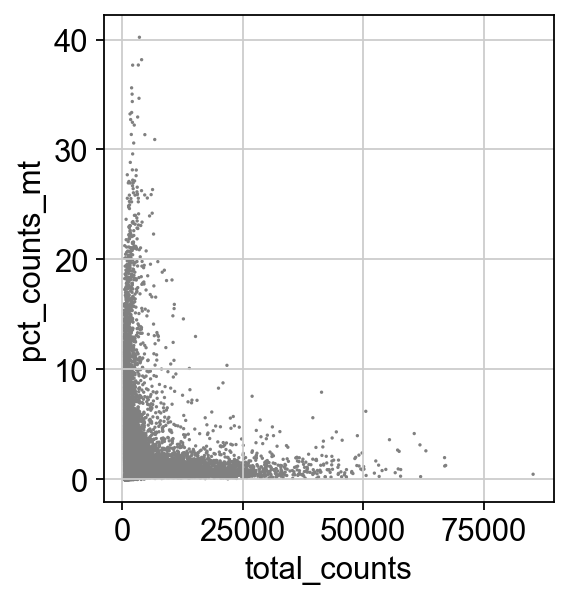

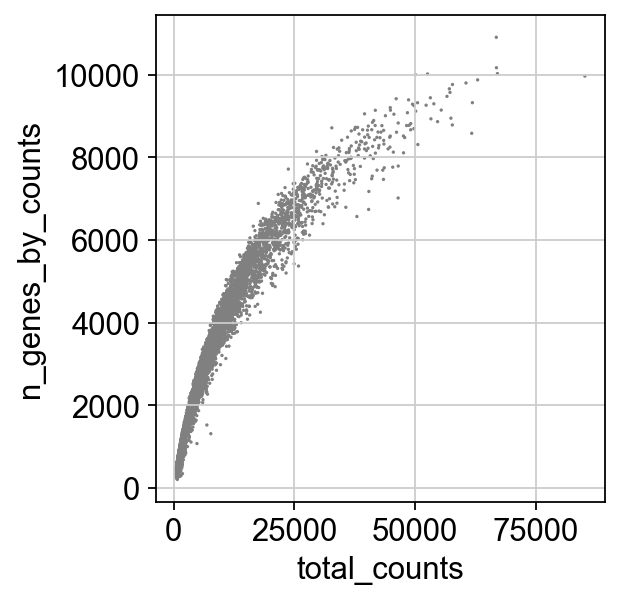

In [68]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [69]:
adata = adata[adata.obs.n_genes_by_counts < 9034, :] # adjusted 2500 to 9034 by previous analysis
adata = adata[adata.obs.pct_counts_mt < 10, :] # under 10 percent as probable cutoff

In [70]:
sc.pp.normalize_total(adata, target_sum=1e4)

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


In [71]:
sc.pp.log1p(adata)

In [73]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


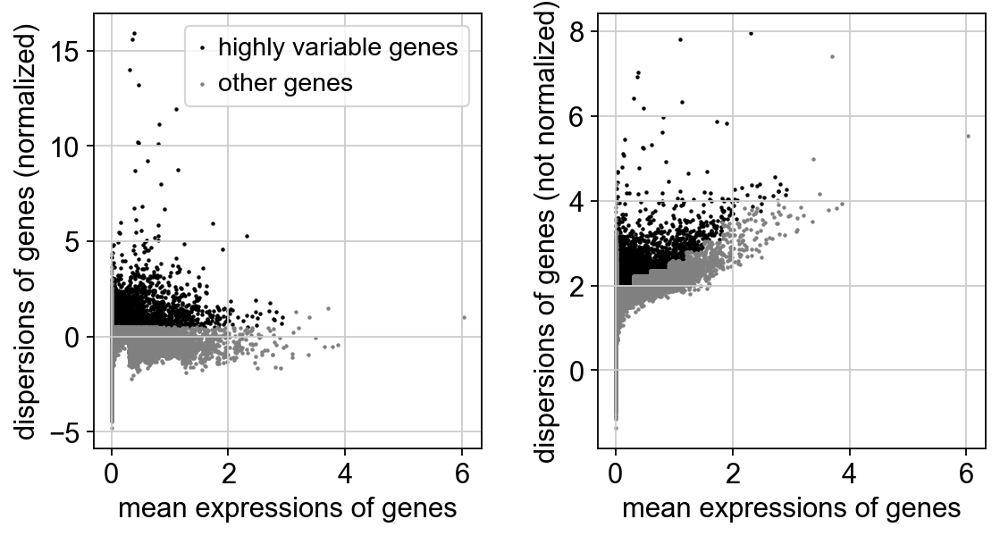

In [74]:
sc.pl.highly_variable_genes(adata)

In [75]:
adata.raw = adata

In [76]:
adata = adata[:, adata.var.highly_variable]

In [77]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:58)


In [78]:
sc.pp.scale(adata, max_value=10)

In [79]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)


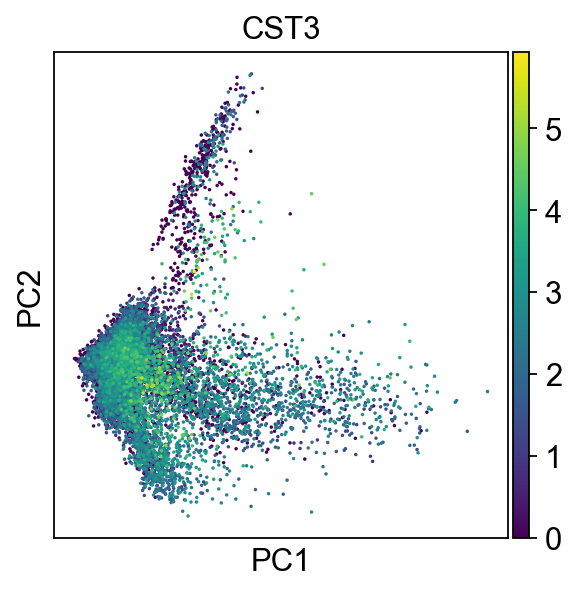

In [80]:
sc.pl.pca(adata, color='CST3')

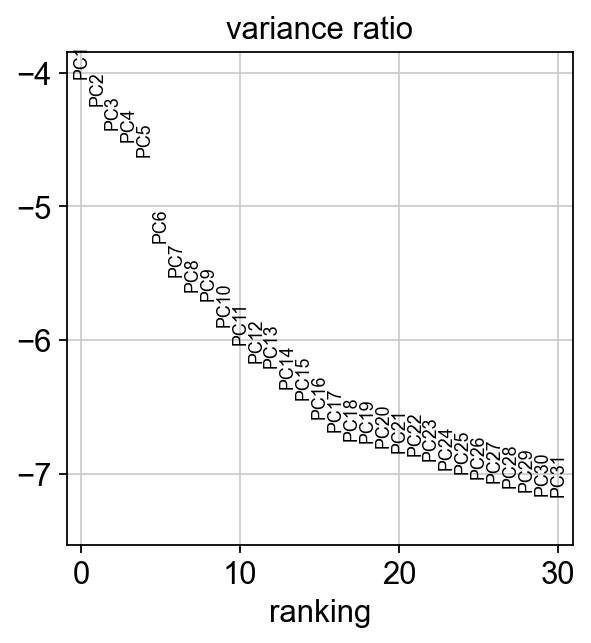

In [81]:
sc.pl.pca_variance_ratio(adata, log=True)

In [82]:
# adata.write(results_file)

In [83]:
adata

AnnData object with n_obs × n_vars = 12196 × 6095
    obs: 'donor_identity', 'donor_id', 'cluster_label', 'lowres_cluster_label', 'sample_id', 'bucket', 'disorder', 'paper_doublet_scores', 'paper_predicted_doublets', 'doublet_score', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [84]:
sc.pp.neighbors(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:13)


In [85]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


In [86]:
print(adata.obs)

                       donor_identity    donor_id  \
Barcode                                             
AAACCCAAGGATGAGA-1  Hash454-TotalSeqA      donor0   
AAACCCAAGGTACCTT-1           negative  unassigned   
AAACCCAAGTCATTGC-1  Hash454-TotalSeqA      donor0   
AAACCCAAGTTGGAGC-1  Hash453-TotalSeqA      donor3   
AAACCCACAAGGCTTT-1  Hash453-TotalSeqA      donor3   
...                               ...         ...   
TTTGTTGTCCACTTTA-1  Hash453-TotalSeqA      donor3   
TTTGTTGTCCCTCTAG-1  Hash455-TotalSeqA      donor1   
TTTGTTGTCCGTACGG-1  Hash456-TotalSeqA      donor5   
TTTGTTGTCGCTTGAA-1  Hash456-TotalSeqA      donor5   
TTTGTTGTCGTAACTG-1  Hash456-TotalSeqA      donor5   

                                         cluster_label  \
Barcode                                                  
AAACCCAAGGATGAGA-1                                 NaN   
AAACCCAAGGTACCTT-1                                 NaN   
AAACCCAAGTCATTGC-1  OG - OPALINlow_SLC5A11low_RBFOXlow   
AAACCCAAGTTGGAGC-1  

In [87]:
sc.tl.leiden(adata)

running Leiden clustering
    finished: found 29 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [88]:
sc.tl.leiden(adata, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1.0)
sc.tl.leiden(adata, key_added="leiden_res2", resolution=2.0)

running Leiden clustering
    finished: found 15 clusters and added
    'leiden_res0_25', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_res0_5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 29 clusters and added
    'leiden_res1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 41 clusters and added
    'leiden_res2', the cluster labels (adata.obs, categorical) (0:00:01)


/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


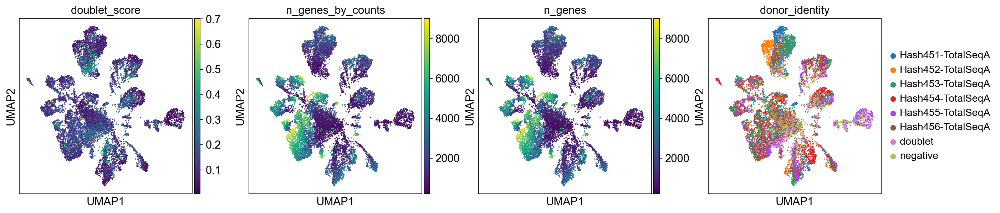

In [89]:
sc.pl.umap(adata, color=['doublet_score', 'n_genes_by_counts', 'n_genes', 'donor_identity'])

Add a column to adata.obs that only shows doublet vs. no doublet.

In [90]:
doublet_boolean = adata.obs['donor_identity'].str.contains("doublet")
adata.obs['doublet_classification_pipeline'] = ['doublet' if result else 'no doublet' for result in doublet_boolean]

In [91]:
adata.obs

,donor_identity,donor_id,cluster_label,lowres_cluster_label,sample_id,bucket,disorder,paper_doublet_scores,paper_predicted_doublets,doublet_score,...,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,leiden_res0_25,leiden_res0_5,leiden_res1,leiden_res2,doublet_classification_pipeline
Barcode,,,,,,,,,,,,,,,,,,,,,
AAACCCAAGGATGAGA-1,Hash454-TotalSeqA,donor0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.169576,...,461,623.0,40.0,6.420546,5,0,1,5,7,no doublet
AAACCCAAGGTACCTT-1,negative,unassigned,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.043624,...,452,564.0,24.0,4.255319,2,5,6,2,1,no doublet
AAACCCAAGTCATTGC-1,Hash454-TotalSeqA,donor0,OG - OPALINlow_SLC5A11low_RBFOXlow,OG - OPALINlow_SLC5A11low_RBFOXlow,761433_GX38,oligodendrocytes,ms,0.152860,False,0.216216,...,784,1023.0,13.0,1.270772,3,1,0,3,3,no doublet
AAACCCAAGTTGGAGC-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.129630,...,2775,5384.0,161.0,2.990342,8,2,2,8,8,no doublet
AAACCCACAAGGCTTT-1,Hash453-TotalSeqA,donor3,SmoothMusc-ACTA2hi_CNN1pos,Endo,761433_GX38,endothelial,ms,0.090532,False,0.155920,...,834,1146.0,55.0,4.799302,14,4,4,14,23,no doublet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCCACTTTA-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.123260,...,1919,3421.0,342.0,9.997077,6,0,1,6,31,no doublet
TTTGTTGTCCCTCTAG-1,Hash455-TotalSeqA,donor1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.050929,...,1123,2605.0,3.0,0.115163,12,7,10,12,11,no doublet
TTTGTTGTCCGTACGG-1,Hash456-TotalSeqA,donor5,OG - OPALINhi_PLXDC2hi,OG - OPALINhi_PLXDC2hi,761433_GX38,oligodendrocytes,ms,0.033449,False,0.058073,...,2092,3912.0,13.0,0.332311,4,1,0,4,2,no doublet


/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


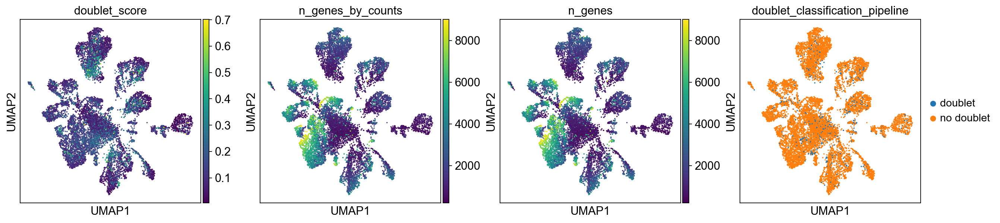

In [92]:
sc.pl.umap(adata, color=['doublet_score', 'n_genes_by_counts', 'n_genes', 'doublet_classification_pipeline'])

Generating a column that labels all NaN cells in the bucket column as new. Then combine these with the leiden_clustering.

In [93]:
adata.obs['newold'] = np.where(pd.isna(adata.obs['bucket']), 'new', 'old')
adata.obs["leiden_new_old"]=adata.obs['leiden'].str.cat(adata.obs['newold'], sep='_')
adata.obs["leiden_res0_25_new_old"]=adata.obs['leiden_res0_25'].str.cat(adata.obs['newold'], sep='_')

Plotting Violin plots to compare the new and paper given doublet scores.

Text(0.5, 1.0, 'Comparison of Doublet Scores between paper scores and newly generated scores with new cells included')

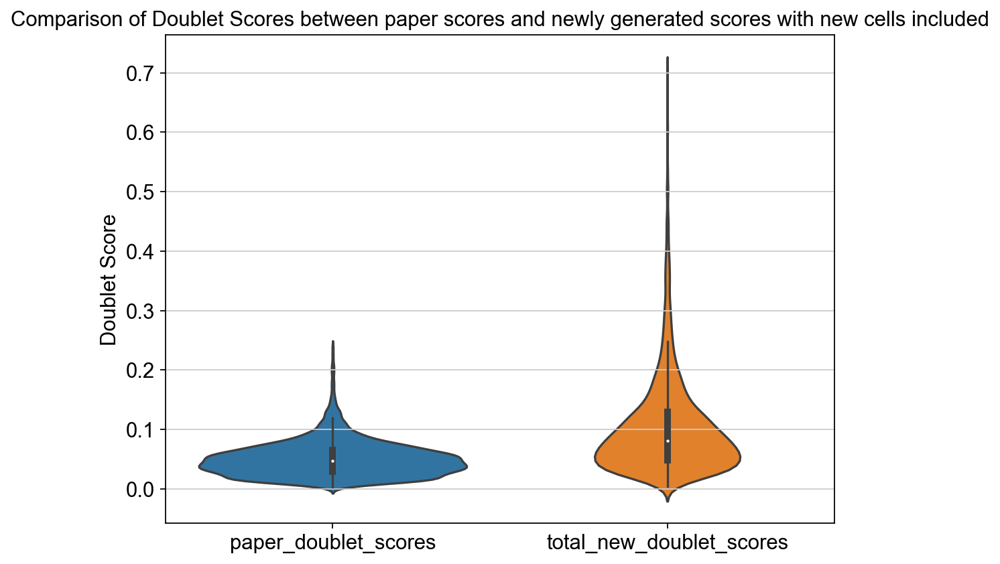

In [94]:
import matplotlib.pyplot as plt
import seaborn as sns

paper_doublet_scores = adata.obs["paper_doublet_scores"]

doublet_scores_df = pd.DataFrame({'paper_doublet_scores': paper_doublet_scores, 'total_new_doublet_scores': adata.obs["doublet_score"]})

plt.figure(figsize=(8, 6))
sns.violinplot(data=doublet_scores_df, save="violet_doublets_all_cells.png")
plt.ylabel('Doublet Score')
plt.title('Comparison of Doublet Scores between paper scores and newly generated scores with new cells included')

Text(0.5, 1.0, 'Comparison of Doublet Scores between paper scores and newly generated scores without new cells included')

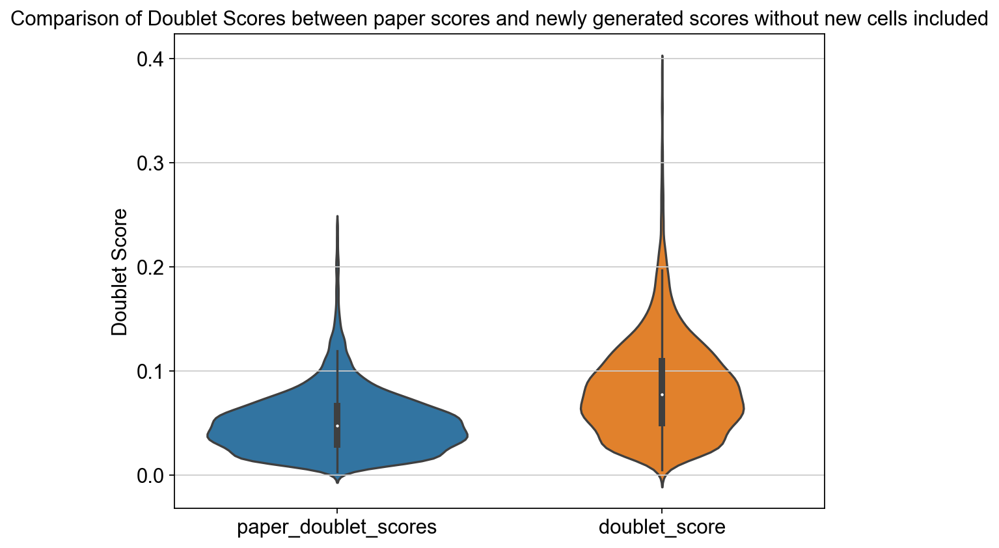

In [95]:
adata_old = adata[adata.obs['newold'] == 'old']

data_to_plot = adata_old.obs.loc[:, ['paper_doublet_scores', 'doublet_score']]

plt.figure(figsize=(8, 6))
sns.violinplot(data=data_to_plot, save="violet_doublets_old_cells.png")
plt.ylabel('Doublet Score')
plt.title('Comparison of Doublet Scores between paper scores and newly generated scores without new cells included')

Text(0.5, 1.0, 'Comparison of Doublet Scores between paper scores and newly generated scores with new cells included')

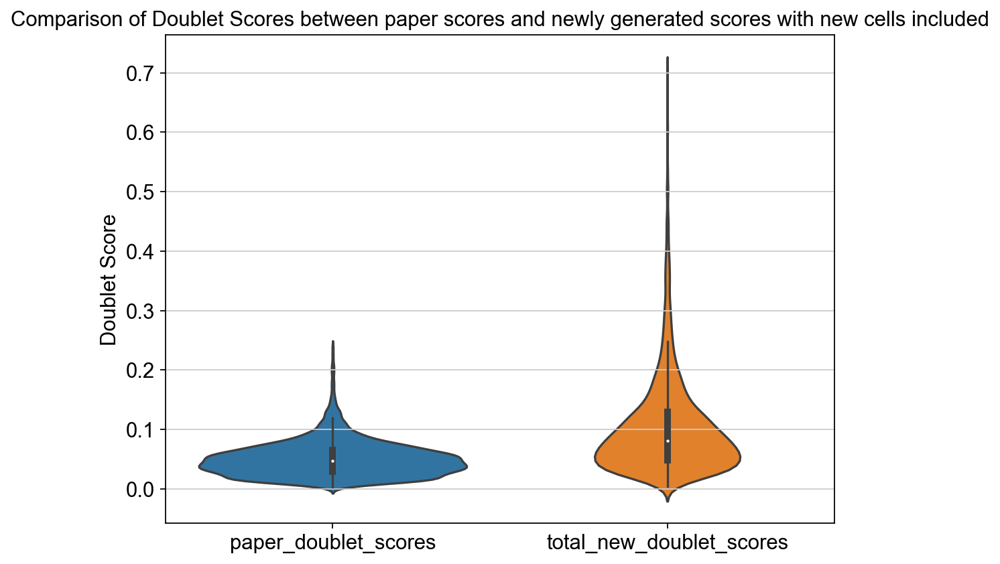

In [96]:
paper_doublet_scores = adata.obs["paper_doublet_scores"]

doublet_scores_df_2 = pd.DataFrame({'paper_doublet_scores': paper_doublet_scores, 'total_new_doublet_scores': adata.obs["doublet_score"]})

plt.figure(figsize=(8, 6))
sns.violinplot(data=doublet_scores_df, save=".png")
plt.ylabel('Doublet Score')
plt.title('Comparison of Doublet Scores between paper scores and newly generated scores with new cells included')

Plotting the cell type description the paper gave over all cells including the new ones to identify clusters.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


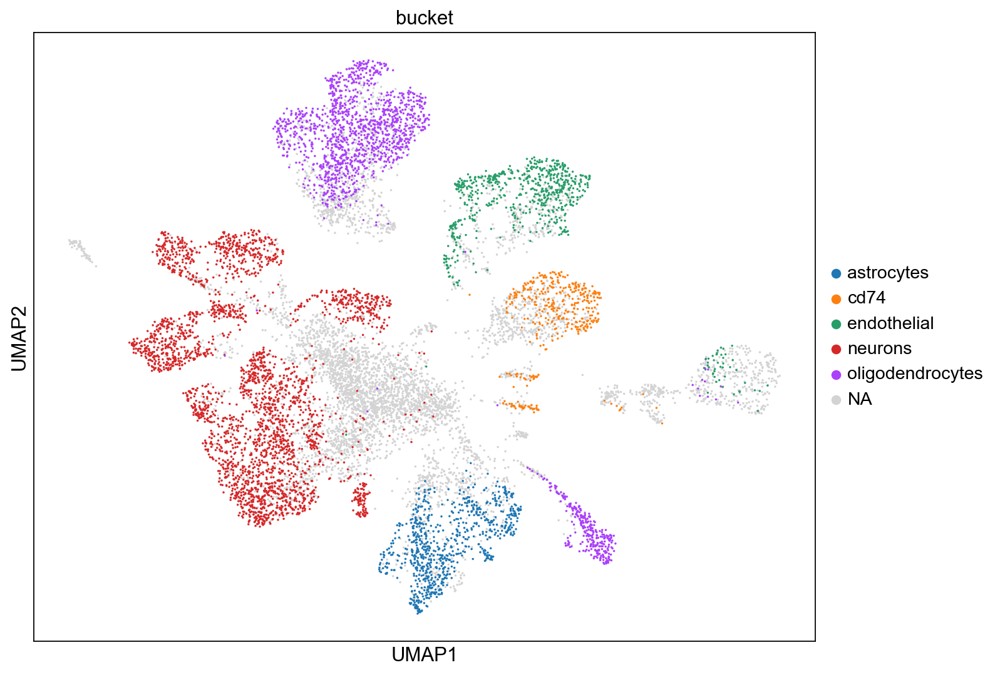

In [97]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(10, 8))
plt.show(sc.pl.umap(adata, color=["bucket"], ax=ax))

Plotting a donor_id colored umap.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


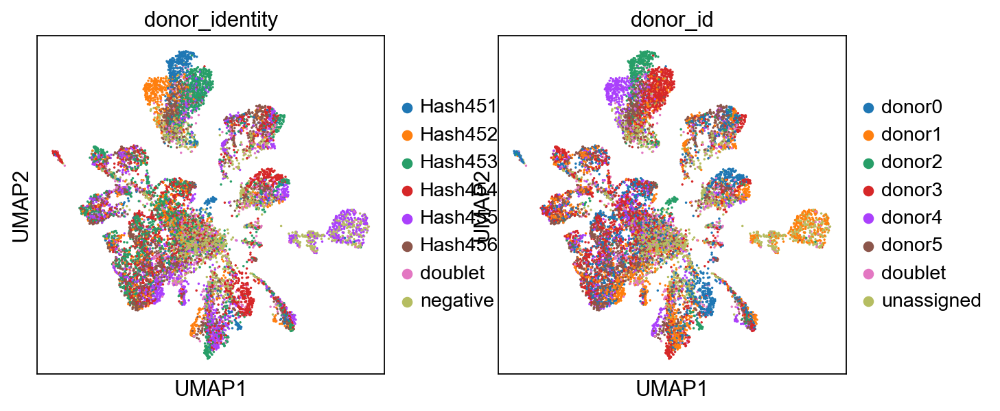

In [98]:
sc.pl.umap(adata, save=".png", color=["donor_identity", "donor_id"])

Excluding cells that had no donor_id and plot them.

                       donor_identity donor_id  \
Barcode                                          
AAACCCAAGGATGAGA-1  Hash454-TotalSeqA   donor0   
AAACCCAAGTCATTGC-1  Hash454-TotalSeqA   donor0   
AAACCCAAGTTGGAGC-1  Hash453-TotalSeqA   donor3   
AAACCCACAAGGCTTT-1  Hash453-TotalSeqA   donor3   
AAACCCACACACAGCC-1  Hash453-TotalSeqA   donor3   
...                               ...      ...   
TTTGTTGTCCACTTTA-1  Hash453-TotalSeqA   donor3   
TTTGTTGTCCCTCTAG-1  Hash455-TotalSeqA   donor1   
TTTGTTGTCCGTACGG-1  Hash456-TotalSeqA   donor5   
TTTGTTGTCGCTTGAA-1  Hash456-TotalSeqA   donor5   
TTTGTTGTCGTAACTG-1  Hash456-TotalSeqA   donor5   

                                         cluster_label  \
Barcode                                                  
AAACCCAAGGATGAGA-1                                 NaN   
AAACCCAAGTCATTGC-1  OG - OPALINlow_SLC5A11low_RBFOXlow   
AAACCCAAGTTGGAGC-1                                 NaN   
AAACCCACAAGGCTTT-1          SmoothMusc-ACTA2hi_CNN1pos   
A

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


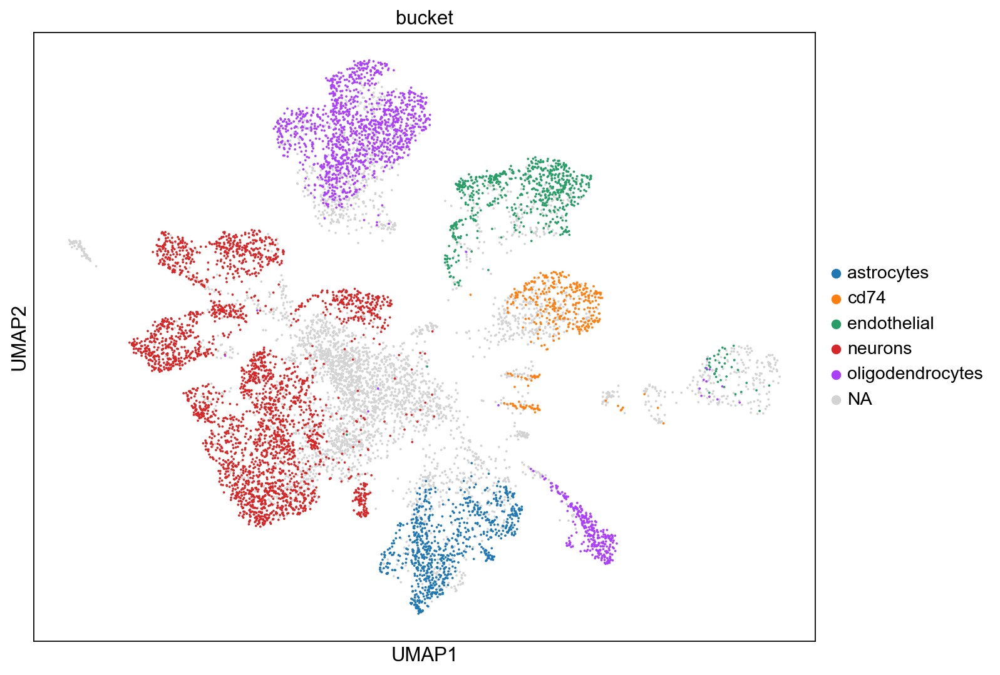

In [99]:
adata_donor_assigned = adata[~(adata.obs['donor_identity'] == 'negative'), :]
print(adata_donor_assigned.obs)
fig, ax = plt.subplots(figsize=(10, 8))
plt.show(sc.pl.umap(adata_donor_assigned, color=["bucket"], ax=ax))

Used Xichens doublet prediction to filter out doublets.

In [100]:
adata_donor_assigned_no_doublets = adata_donor_assigned[~(adata_donor_assigned.obs['donor_identity'] == 'doublet'), :]
print(adata_donor_assigned_no_doublets)

View of AnnData object with n_obs × n_vars = 9791 × 6095
    obs: 'donor_identity', 'donor_id', 'cluster_label', 'lowres_cluster_label', 'sample_id', 'bucket', 'disorder', 'paper_doublet_scores', 'paper_predicted_doublets', 'doublet_score', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'leiden_res2', 'doublet_classification_pipeline', 'newold', 'leiden_new_old', 'leiden_res0_25_new_old'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'donor_identity_colors', 'doublet_classification_pipeline_colors', 'bucket_colors', 'donor_id_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


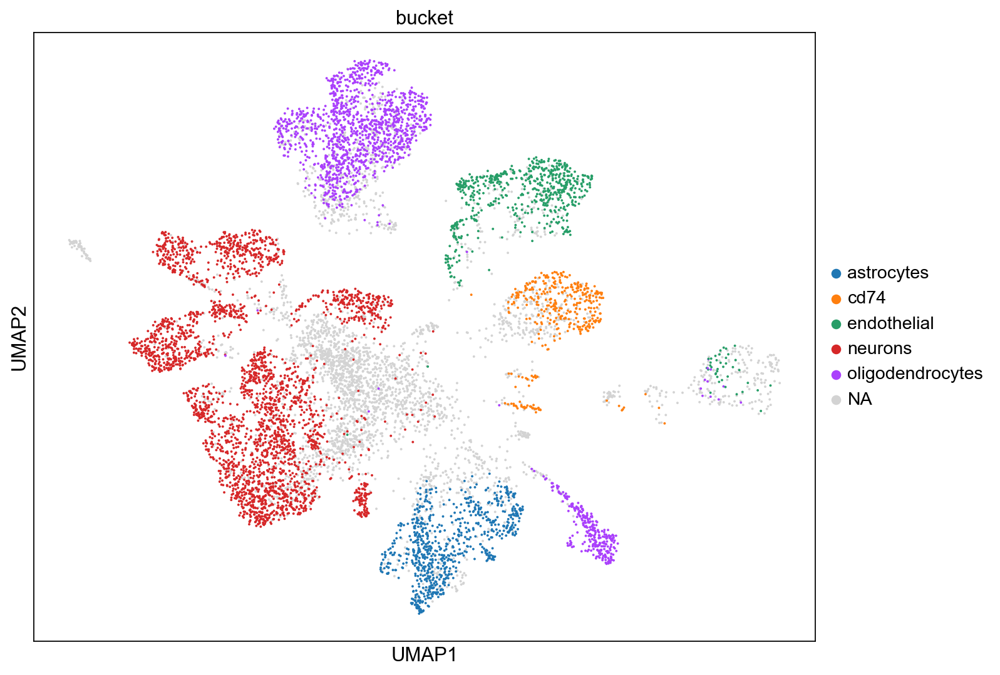

In [101]:
fig, ax = plt.subplots(figsize=(10, 8))
plt.show(sc.pl.umap(adata_donor_assigned_no_doublets, color=["bucket"], ax=ax))

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


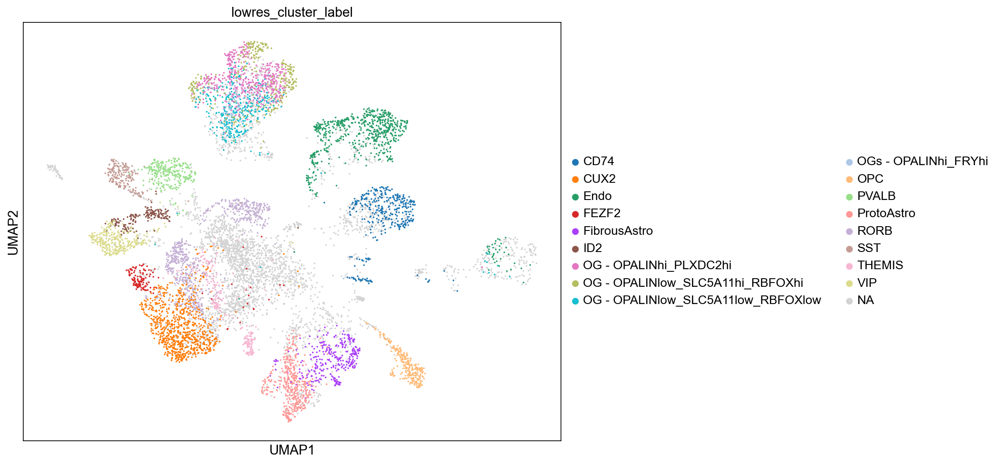

In [102]:
fig, ax = plt.subplots(figsize=(10, 8))
plt.show(sc.pl.umap(adata_donor_assigned_no_doublets, color=["lowres_cluster_label"], ax=ax))

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


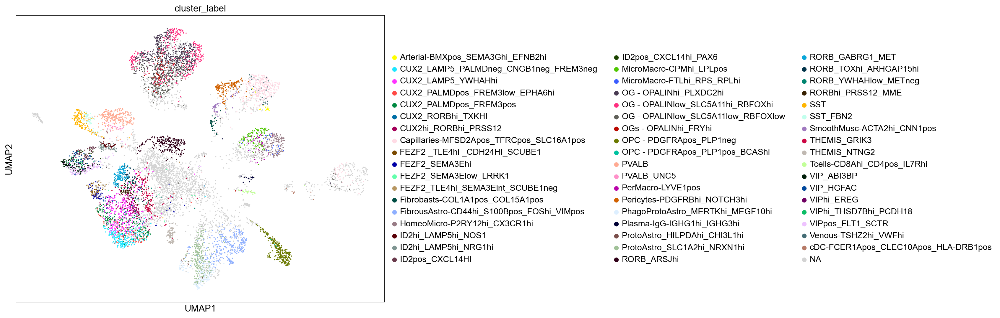

In [103]:
fig, ax = plt.subplots(figsize=(10, 8))
plt.show(sc.pl.umap(adata_donor_assigned_no_doublets, color=["cluster_label"], ax=ax))

Plotting doublet parameters after removal of Xichens doublets and unassigned.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


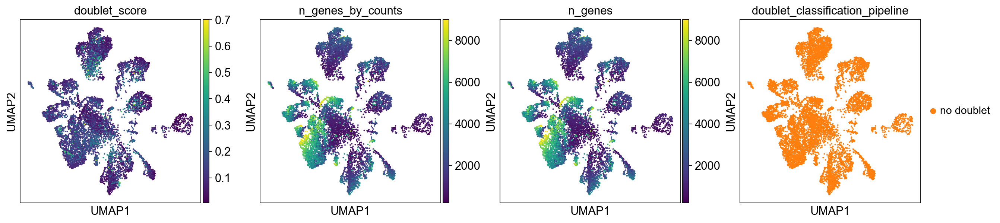

In [104]:
sc.pl.umap(adata_donor_assigned_no_doublets, color=['doublet_score', 'n_genes_by_counts', 'n_genes', 'doublet_classification_pipeline'])

Plotting leiden clusters.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


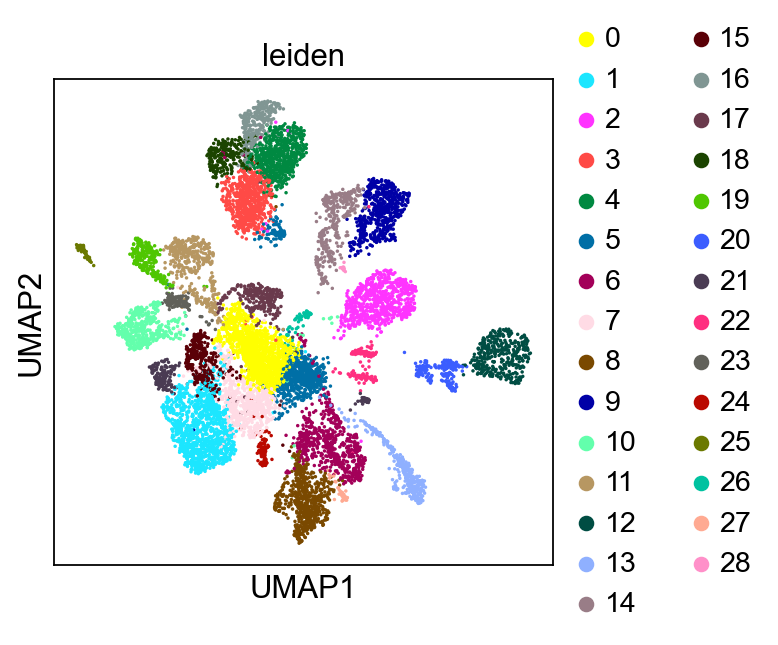

In [105]:
sc.pl.umap(adata, color=['leiden'])

Showing ranked genes by t-test.

ranking genes


/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning:

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


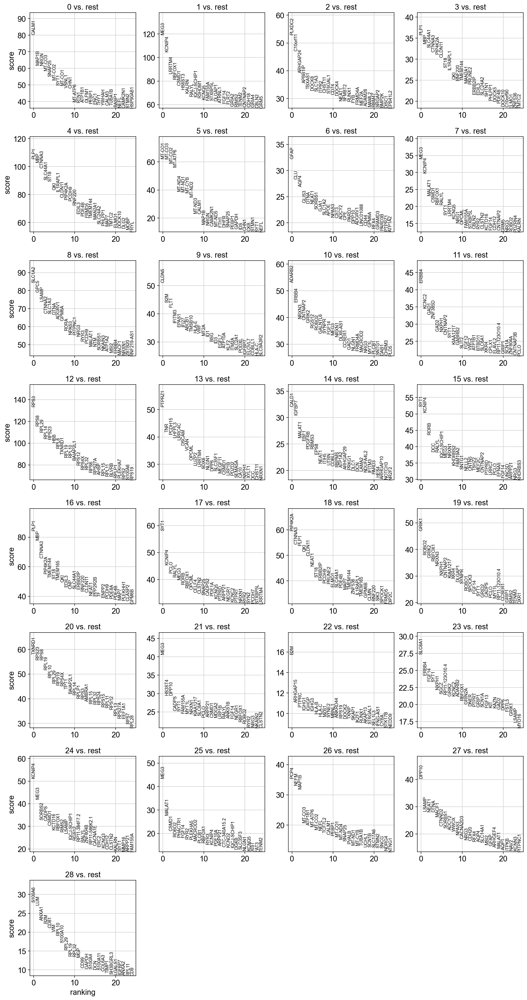

In [106]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [107]:
sc.settings.verbosity = 2  # reduce the verbosity

Showing ranked genes by wilcoxon.

ranking genes


/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning:

    finished (0:00:43)


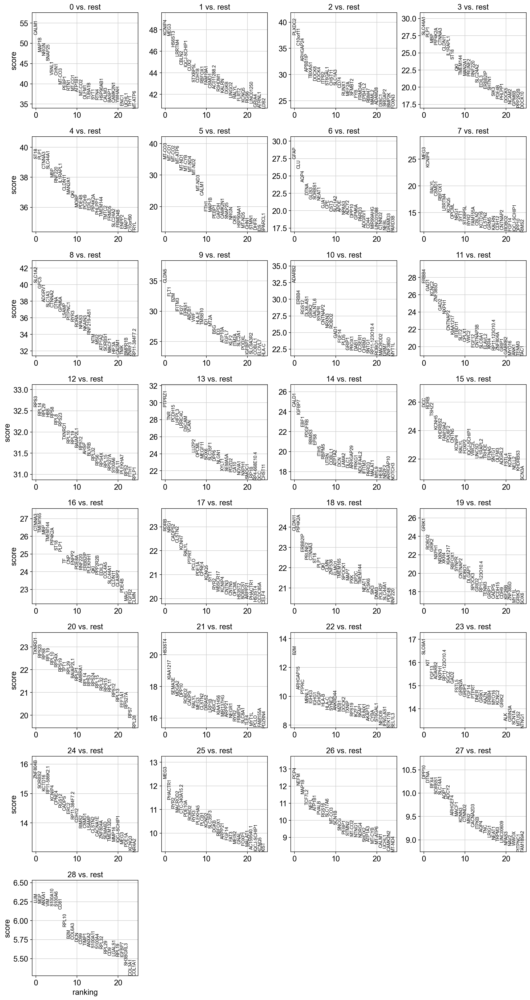

In [110]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

Plotting different leiden resolutions.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


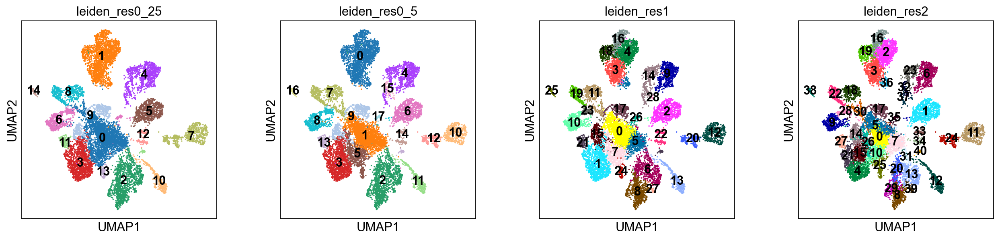

In [109]:
sc.pl.umap(
    adata,
    color=["leiden_res0_25", "leiden_res0_5", "leiden_res1", "leiden_res2"],
    legend_loc="on data",
)

Looking more closely at the new leiden cluster 25 with QC parameters. 

In [112]:
cluster_25 = adata.obs[adata.obs['leiden'] == '25']

In [113]:
cluster_25['doublet_score'].describe()

count    57.000000
mean      0.151095
std       0.079296
min       0.073913
25%       0.111732
50%       0.129630
75%       0.155920
max       0.568493
Name: doublet_score, dtype: float64

In [114]:
adata.obs['doublet_score'].describe()

count    12196.000000
mean         0.103329
std          0.082946
min          0.004494
25%          0.048738
50%          0.080793
75%          0.129630
max          0.701245
Name: doublet_score, dtype: float64

In [115]:
cluster_25['n_genes_by_counts'].describe()

count      57.000000
mean     2073.684211
std      1622.250137
min       438.000000
25%       872.000000
50%      1387.000000
75%      2692.000000
max      7018.000000
Name: n_genes_by_counts, dtype: float64

In [116]:
adata.obs['n_genes_by_counts'].describe()

count    12196.000000
mean      2047.624877
std       1788.923343
min        208.000000
25%        702.000000
50%       1376.500000
75%       2732.000000
max       9009.000000
Name: n_genes_by_counts, dtype: float64

In [117]:
cluster_25['n_genes'].describe()

count      57.000000
mean     2073.877193
std      1622.506813
min       438.000000
25%       873.000000
50%      1387.000000
75%      2692.000000
max      7020.000000
Name: n_genes, dtype: float64

In [118]:
adata.obs['n_genes'].describe()

count    12196.000000
mean      2047.836668
std       1789.183931
min        209.000000
25%        702.000000
50%       1376.500000
75%       2732.000000
max       9009.000000
Name: n_genes, dtype: float64

Showing that there are no NaN values or NA in the original metadata from the gx38-cells in the 'bucket' category. This means that all NaN values (all grey cells in the umap) are new cells.

In [119]:
number_nan_meta_all = obs_meta_all['bucket'].isna().sum()
print('Number of NaN values:', number_nan_meta_all)

Number of NaN values: 0


In [120]:
unique_values_gx38_bucket = obs_meta_all_gx38['bucket'].unique()
print(unique_values_gx38_bucket)

['astrocytes' 'endothelial' 'oligodendrocytes' 'cd74' 'neurons']


ranking genes
    finished (0:00:03)


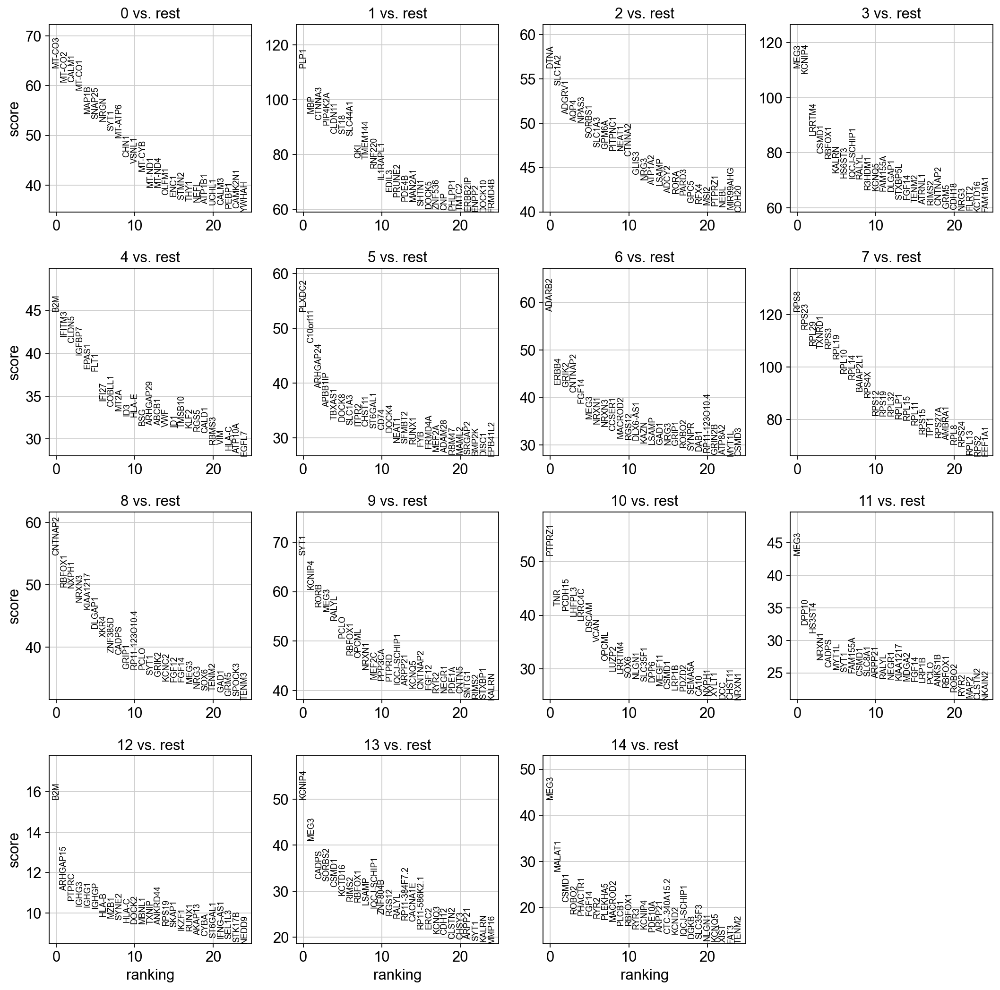

In [121]:
sc.tl.rank_genes_groups(adata, 'leiden_res0_25', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [ ]:
neurons_old = adata_donor_assigned_no_doublets[(adata_donor_assigned_no_doublets.obs['bucket'] == 'neurons'), :]
print(neurons_old)

neurons_new_1 = adata_donor_assigned_no_doublets[(adata_donor_assigned_no_doublets.obs['leiden_res0_25'] == '1'), :]
print(neurons_new_1)
neurons_new_5 = adata_donor_assigned_no_doublets[(adata_donor_assigned_no_doublets.obs['leiden_res0_25'] == '5'), :]
print(neurons_new_5)

In [ ]:
ratio_new_old_neurons = (((len(neurons_new_1.obs) + len(neurons_new_5.obs)) / len(neurons_old.obs)) * 100) - 100
print("We have found", ratio_new_old_neurons, "percent more neurons than in the original count.")

In [ ]:
import anndata as ad
neurons_new = ad.concat([neurons_new_1, neurons_new_5], axis=0)

Comparing the old neuron clusters with the new cells in these clusters.

In [ ]:
sc.pl.umap(
    neurons_new, save=".png",
    color=["bucket"]
)

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


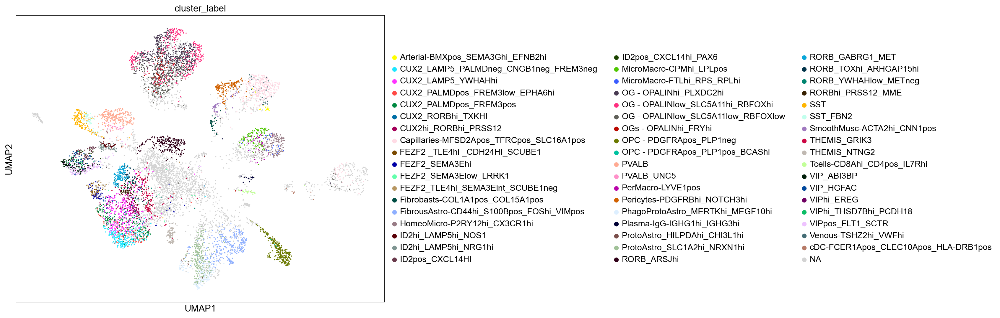

In [122]:
fig, ax = plt.subplots(figsize=(10, 8))
plt.show(sc.pl.umap(adata_donor_assigned_no_doublets, color=["cluster_label"], ax=ax))

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


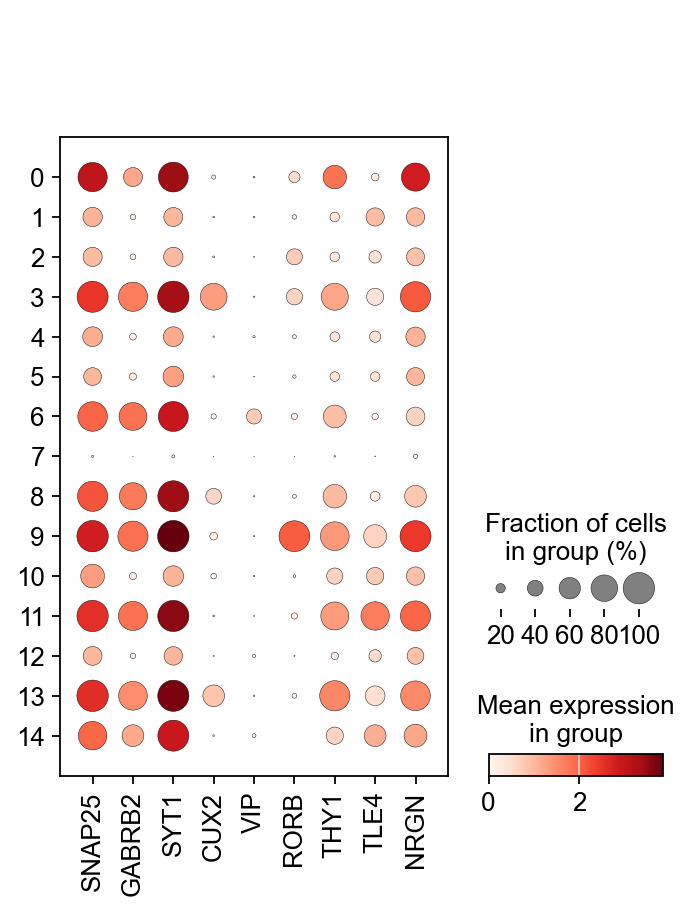

In [123]:
sc.pl.dotplot(adata_donor_assigned_no_doublets, ["SNAP25", "GABRB2", "SYT1", "CUX2", "VIP", "RORB", "THY1", "TLE4", "NRGN"], groupby='leiden_res0_25')

Plotting a small overview of all leiden 0.25 clusters with 3 dotplots with different genes included.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


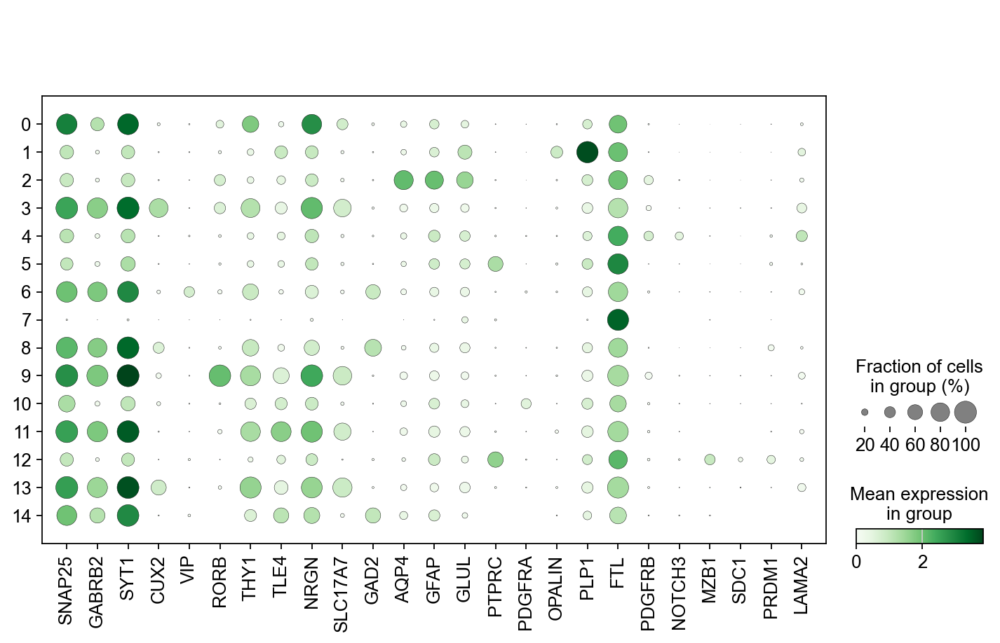

In [124]:
sc.pl.dotplot(adata_donor_assigned_no_doublets, ["SNAP25",
                                                 "GABRB2",
                                                 "SYT1",
                                                 "CUX2",
                                                 "VIP",
                                                 "RORB",
                                                 "THY1",
                                                 "TLE4",
                                                 "NRGN",
                                                 "SLC17A7",
                                                 "GAD2",
                                                 "AQP4",
                                                 "GFAP",
                                                 "GLUL",
                                                 "PTPRC",
                                                 "PDGFRA",
                                                 "OPALIN",
                                                 "PLP1",
                                                 "FTL",
                                                 "PDGFRB",
"NOTCH3",
"MZB1",
"SDC1",
"PRDM1",
"LAMA2",
                                                ], color_map='Greens',groupby='leiden_res0_25')

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


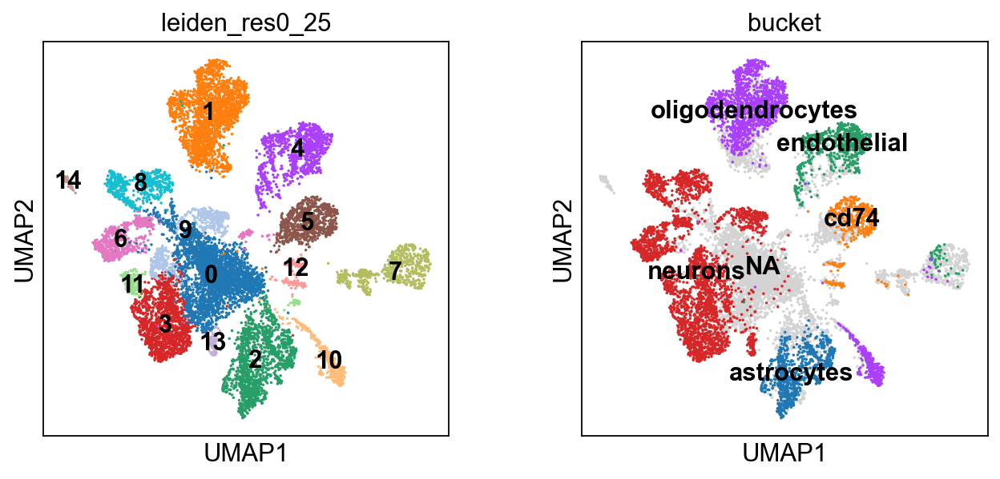

In [125]:
sc.pl.umap(
    adata,
    color=["leiden_res0_25", "bucket"],
    legend_loc="on data", save="leiden025_bucket.png"
)

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


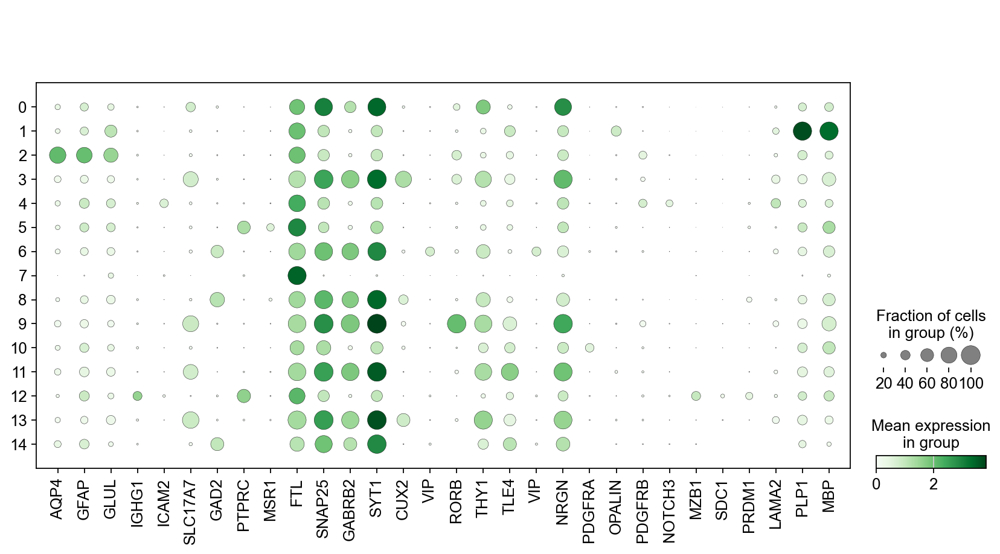

In [126]:
sc.pl.dotplot(adata_donor_assigned_no_doublets, [
"AQP4",
"GFAP",
"GLUL",
"IGHG1",
"ICAM2",
"SLC17A7",
"GAD2",
"PTPRC",
"MSR1",
"FTL",
"SNAP25",
"GABRB2",
"SYT1",
"CUX2",
"VIP",
"RORB",
"THY1",
"TLE4",
"VIP",
"NRGN",
"PDGFRA",
"OPALIN",
"PDGFRB",
"NOTCH3",
"MZB1",
"SDC1",
"PRDM1",
"LAMA2",
"PLP1",
"MBP"
                                                ], color_map='Greens', groupby='leiden_res0_25')

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


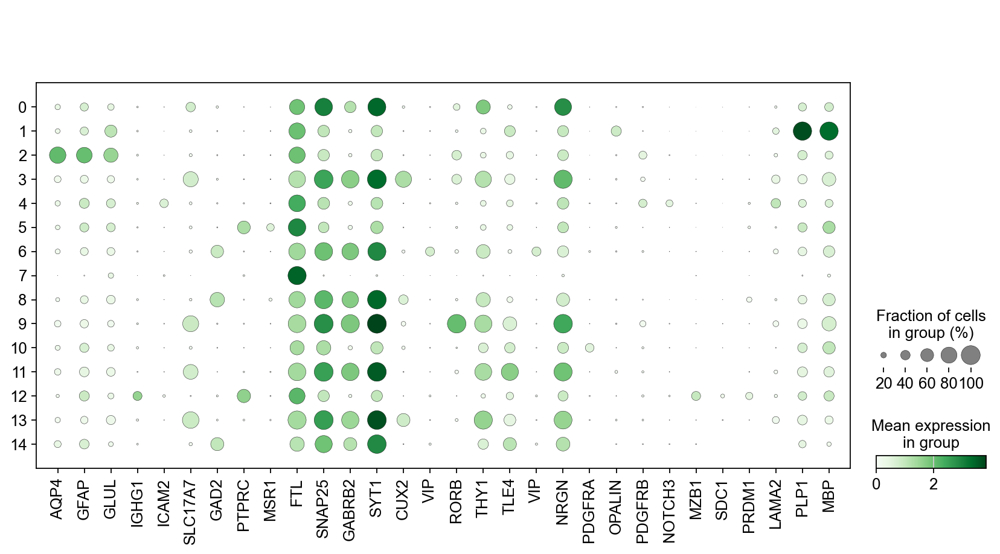

In [127]:
sc.pl.dotplot(adata_donor_assigned_no_doublets, [
"AQP4",
"GFAP",
"GLUL",
"IGHG1",
"ICAM2",
"SLC17A7",
"GAD2",
"PTPRC",
"MSR1",
"FTL",
"SNAP25",
"GABRB2",
"SYT1",
"CUX2",
"VIP",
"RORB",
"THY1",
"TLE4",
"VIP",
"NRGN",
"PDGFRA",
"OPALIN",
"PDGFRB",
"NOTCH3",
"MZB1",
"SDC1",
"PRDM1",
"LAMA2",
"PLP1",
"MBP"
                                                ], color_map='Greens', groupby='leiden_res0_25')

In [128]:
adata_donor_assigned_no_doublets_nan_rows = adata_donor_assigned_no_doublets.obs['bucket'].isna()
adata_donor_assigned_no_doublets_nan = adata_donor_assigned_no_doublets[adata_donor_assigned_no_doublets_nan_rows, :]
adata_donor_assigned_no_doublets_nan

View of AnnData object with n_obs × n_vars = 3594 × 6095
    obs: 'donor_identity', 'donor_id', 'cluster_label', 'lowres_cluster_label', 'sample_id', 'bucket', 'disorder', 'paper_doublet_scores', 'paper_predicted_doublets', 'doublet_score', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'leiden_res2', 'doublet_classification_pipeline', 'newold', 'leiden_new_old', 'leiden_res0_25_new_old'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'donor_identity_colors', 'doublet_classification_pipeline_colors', 'bucket_colors', 'donor_id_colors', 'lowres_cluster_label_colors', 'cluster_label_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [129]:
adata_donor_assigned_no_doublets_not_nan_rows = adata_donor_assigned_no_doublets.obs['bucket'].notna()
adata_donor_assigned_no_doublets_not_nan = adata_donor_assigned_no_doublets[adata_donor_assigned_no_doublets_not_nan_rows, :]
adata_donor_assigned_no_doublets_not_nan

View of AnnData object with n_obs × n_vars = 6197 × 6095
    obs: 'donor_identity', 'donor_id', 'cluster_label', 'lowres_cluster_label', 'sample_id', 'bucket', 'disorder', 'paper_doublet_scores', 'paper_predicted_doublets', 'doublet_score', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'leiden_res2', 'doublet_classification_pipeline', 'newold', 'leiden_new_old', 'leiden_res0_25_new_old'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'donor_identity_colors', 'doublet_classification_pipeline_colors', 'bucket_colors', 'donor_id_colors', 'lowres_cluster_label_colors', 'cluster_label_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


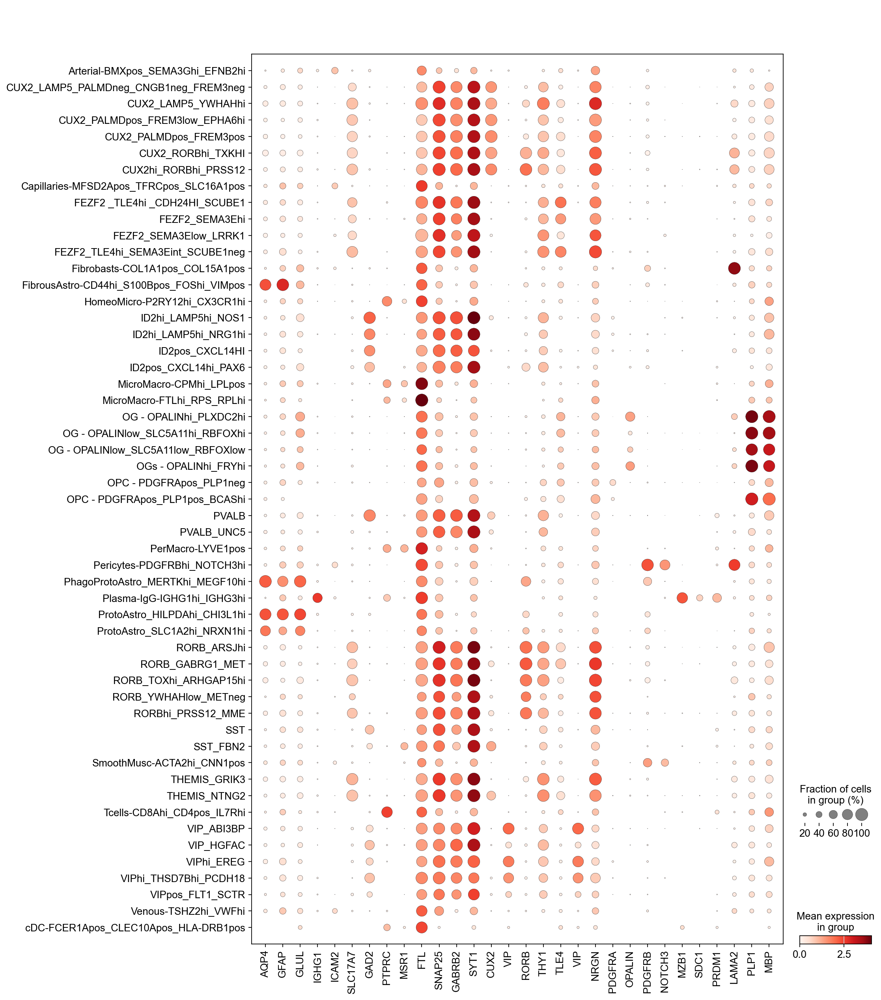

In [130]:
sc.pl.dotplot(adata_donor_assigned_no_doublets_not_nan, [
"AQP4",
"GFAP",
"GLUL",
"IGHG1",
"ICAM2",
"SLC17A7",
"GAD2",
"PTPRC",
"MSR1",
"FTL",
"SNAP25",
"GABRB2",
"SYT1",
"CUX2",
"VIP",
"RORB",
"THY1",
"TLE4",
"VIP",
"NRGN",
"PDGFRA",
"OPALIN",
"PDGFRB",
"NOTCH3",
"MZB1",
"SDC1",
"PRDM1",
"LAMA2",
"PLP1",
"MBP"
                                                ], color_map='Reds', groupby='cluster_label')

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


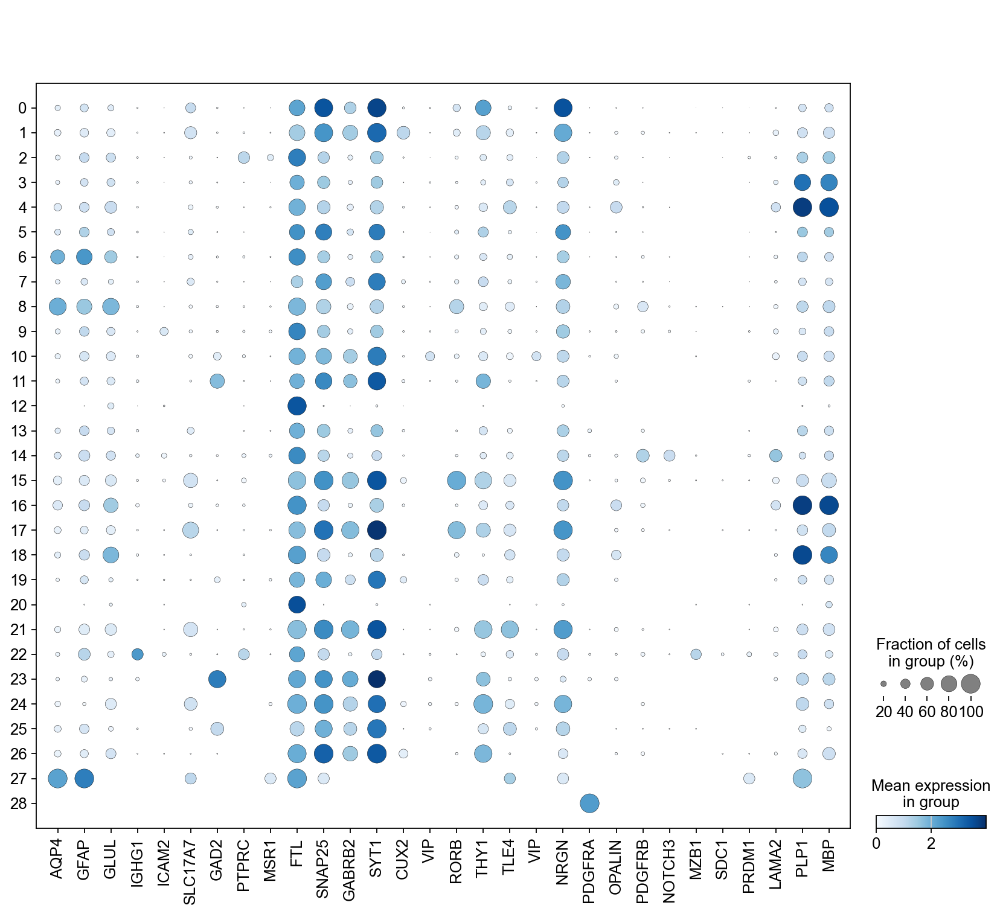

In [131]:
sc.pl.dotplot(adata_donor_assigned_no_doublets_nan, [
"AQP4",
"GFAP",
"GLUL",
"IGHG1",
"ICAM2",
"SLC17A7",
"GAD2",
"PTPRC",
"MSR1",
"FTL",
"SNAP25",
"GABRB2",
"SYT1",
"CUX2",
"VIP",
"RORB",
"THY1",
"TLE4",
"VIP",
"NRGN",
"PDGFRA",
"OPALIN",
"PDGFRB",
"NOTCH3",
"MZB1",
"SDC1",
"PRDM1",
"LAMA2",
"PLP1",
"MBP"
                                                ], color_map='Blues', groupby='leiden')

Big overview for cell Markers.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


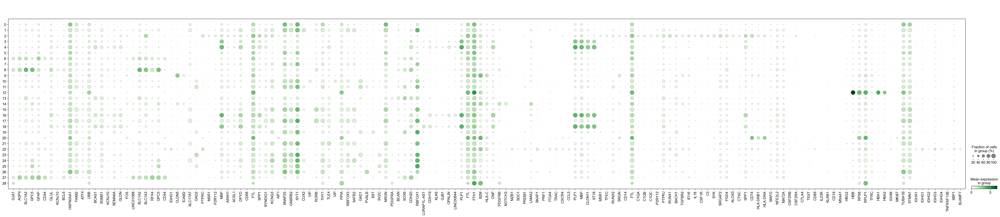

In [132]:
sc.pl.dotplot(adata_donor_assigned_no_doublets, ['GJA1', 'AQP4', 'SLC1A2', 'GPC5', 'GFAP',
'CD44', 'GLUL', 'KCNJ10', 'BCL6', 'HSP90AA1',
'FAIM2', 'ATF4', 'UBB', 'BCAS1', 'SGMS1',
'KCNJ10', 'SEMA6A', 'GLDN', 'FOS', 'LINC01088',
'SLC1A2', 'SLC1A3', 'RFX4', 'GPC5', 'CD44',
'IGHG1', 'CLDN5', 'ICAM2', 'SLC17A7', 'GAD2',
'PTPRC', 'MSR1', 'P2RY12', 'MBP', 'ASAH1',
'ACSL1', 'DPYD', 'CD68', 'FTL', 'SPP1',
'SYNDIG1', 'KCNQ3', 'AIF1', 'SNAP25', 'GABRB2',
'SYT1', 'CUX2', 'VIP', 'RORB', 'THY1',
'TLE4', 'VIP', 'PPIA', 'RBFOX3', 'SATB2',
'GAD1', 'PVALB', 'SST', 'SV2C', 'NRGN',
'PDGFRA', 'BCAN', 'SOX6', 'CDH20', 'RBFOX1',
'LURAP1L-AS1', 'CDH19', 'KLK6', 'GJB1', 'OPALIN',
'LINC00844', 'PLP1',
'FTL', 'FTH1', 'B2M', 'HLA-C', 'CNP',
'PDGFRB', 'NOTCH3', 'MZB1', 'SDC1', 'PRDM1',
'LAMA2', 'SKAP1', 'PRF1', 'ITGA4', 'TRAC',
'CXCR4', 'CCL5', 'PLP1', 'MBP', 'CLDN11',
'ST18', 'MSR1', 'TFEC', 'RUNX2', 'SRGN',
'CD14', 'FTL', 'C1QA', 'C1QB', 'C1QC',
'P2RY12', 'PTPRJ', 'RUNX1', 'BACH1',
'TGFBR2', 'IFI16', 'IL18', 'CSF1R', 'C3',
'SYK', 'SRGAP2', 'FGD4', 'ALOX5',
'CTSC', 'SPP1', 'CD74', 'HLA-DRB1',
'HLA-DRA', 'MAFG', 'NFE2L2',
'MAT2A', 'CSF2RB', 'CSF2RA', 'CTLA4',
'TIGIT', 'CD69', 'IL23R', 'KLRB1',
'CD19', 'MS4A1', 'HBG2', 'HBB', 'RPS6',
'RPLP1', 'TFRC', 'HBA1', 'HBA2', 'IGHM',
'MKI67', 'TUBA1B', 'STMN1', 'IGHA1', 'IGHG1',
'IGHG2', 'IGHG3', 'IGHG4', 'TNFRSF13B', 'XBP1', 'SLAMF7']

                                                , color_map='Greens', groupby='leiden')

Replotted leiden and bucket for reference.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


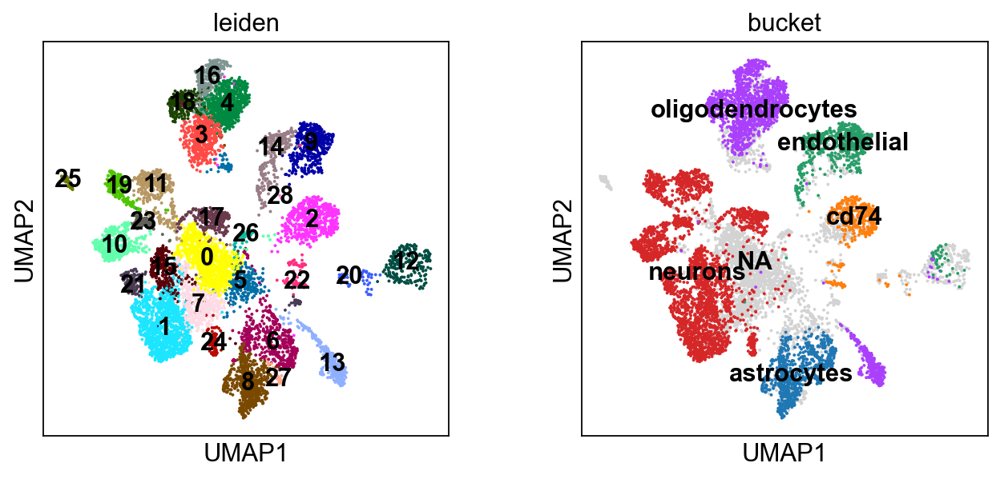

In [133]:
sc.pl.umap(
    adata_donor_assigned_no_doublets,
    color=["leiden", "bucket"],
    legend_loc="on data",
)

In [134]:
adata.obs['newold'] = np.where(pd.isna(adata.obs['bucket']), 'new', 'old')
adata.obs["leiden_new_old"]=adata.obs['leiden'].str.cat(adata.obs['newold'], sep='_')
adata.obs["leiden_res0_25_new_old"]=adata.obs['leiden_res0_25'].str.cat(adata.obs['newold'], sep='_')
adata_donor_assigned_no_doublets.obs['newold'] = np.where(pd.isna(adata_donor_assigned_no_doublets.obs['bucket']), 'new', 'old')
adata_donor_assigned_no_doublets.obs["leiden_new_old"]=adata_donor_assigned_no_doublets.obs['leiden'].str.cat(adata_donor_assigned_no_doublets.obs['newold'], sep='_')
adata_donor_assigned_no_doublets.obs["leiden_res0_25_new_old"]=adata_donor_assigned_no_doublets.obs['leiden_res0_25'].str.cat(adata_donor_assigned_no_doublets.obs['newold'], sep='_')

In [135]:
adata.obs

,donor_identity,donor_id,cluster_label,lowres_cluster_label,sample_id,bucket,disorder,paper_doublet_scores,paper_predicted_doublets,doublet_score,...,pct_counts_mt,leiden,leiden_res0_25,leiden_res0_5,leiden_res1,leiden_res2,doublet_classification_pipeline,newold,leiden_new_old,leiden_res0_25_new_old
Barcode,,,,,,,,,,,,,,,,,,,,,
AAACCCAAGGATGAGA-1,Hash454-TotalSeqA,donor0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.169576,...,6.420546,5,0,1,5,7,no doublet,new,5_new,0_new
AAACCCAAGGTACCTT-1,negative,unassigned,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.043624,...,4.255319,2,5,6,2,1,no doublet,new,2_new,5_new
AAACCCAAGTCATTGC-1,Hash454-TotalSeqA,donor0,OG - OPALINlow_SLC5A11low_RBFOXlow,OG - OPALINlow_SLC5A11low_RBFOXlow,761433_GX38,oligodendrocytes,ms,0.152860,False,0.216216,...,1.270772,3,1,0,3,3,no doublet,old,3_old,1_old
AAACCCAAGTTGGAGC-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.129630,...,2.990342,8,2,2,8,8,no doublet,new,8_new,2_new
AAACCCACAAGGCTTT-1,Hash453-TotalSeqA,donor3,SmoothMusc-ACTA2hi_CNN1pos,Endo,761433_GX38,endothelial,ms,0.090532,False,0.155920,...,4.799302,14,4,4,14,23,no doublet,old,14_old,4_old
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCCACTTTA-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.123260,...,9.997077,6,0,1,6,31,no doublet,new,6_new,0_new
TTTGTTGTCCCTCTAG-1,Hash455-TotalSeqA,donor1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.050929,...,0.115163,12,7,10,12,11,no doublet,new,12_new,7_new
TTTGTTGTCCGTACGG-1,Hash456-TotalSeqA,donor5,OG - OPALINhi_PLXDC2hi,OG - OPALINhi_PLXDC2hi,761433_GX38,oligodendrocytes,ms,0.033449,False,0.058073,...,0.332311,4,1,0,4,2,no doublet,old,4_old,1_old


Showing dotplots comparing new and old cells.

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


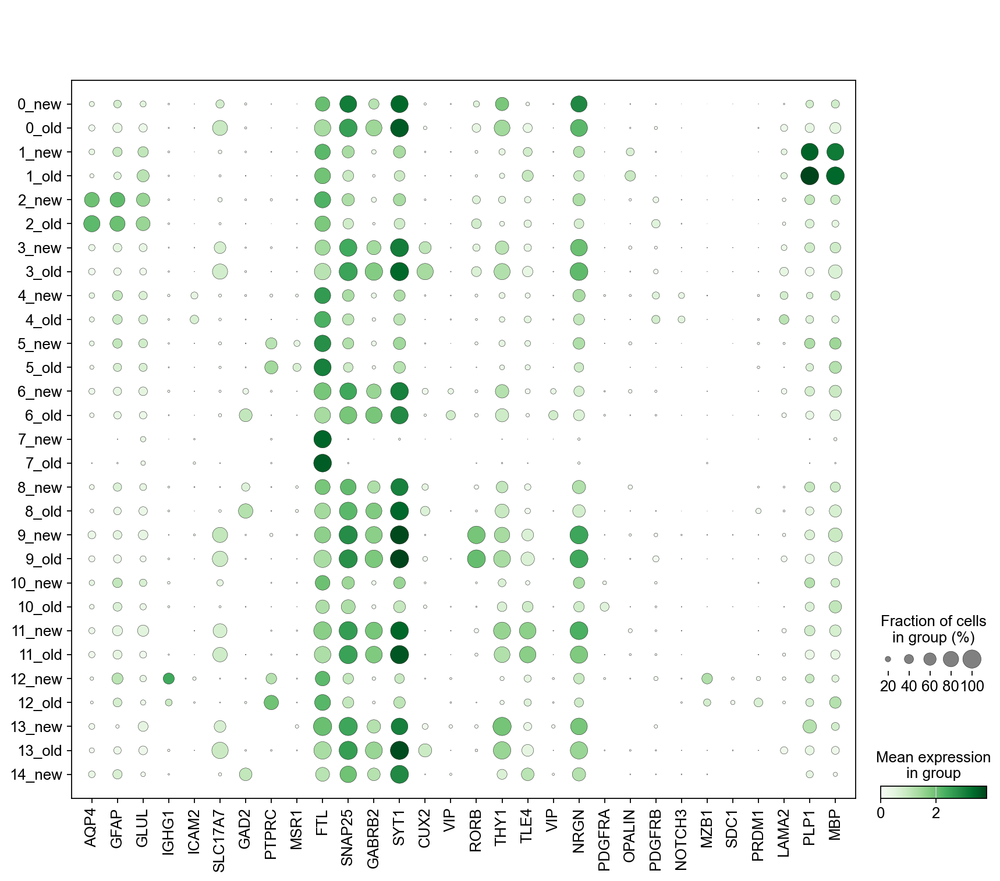

In [136]:
marker_genes = ["AQP4",
"GFAP",
"GLUL",
"IGHG1",
"ICAM2",
"SLC17A7",
"GAD2",
"PTPRC",
"MSR1",
"FTL",
"SNAP25",
"GABRB2",
"SYT1",
"CUX2",
"VIP",
"RORB",
"THY1",
"TLE4",
"VIP",
"NRGN",
"PDGFRA",
"OPALIN",
"PDGFRB",
"NOTCH3",
"MZB1",
"SDC1",
"PRDM1",
"LAMA2",
"PLP1",
"MBP"]
sc.pl.dotplot(adata_donor_assigned_no_doublets, marker_genes, color_map='Greens', save="new_old_leiden025.png", groupby='leiden_res0_25_new_old')

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


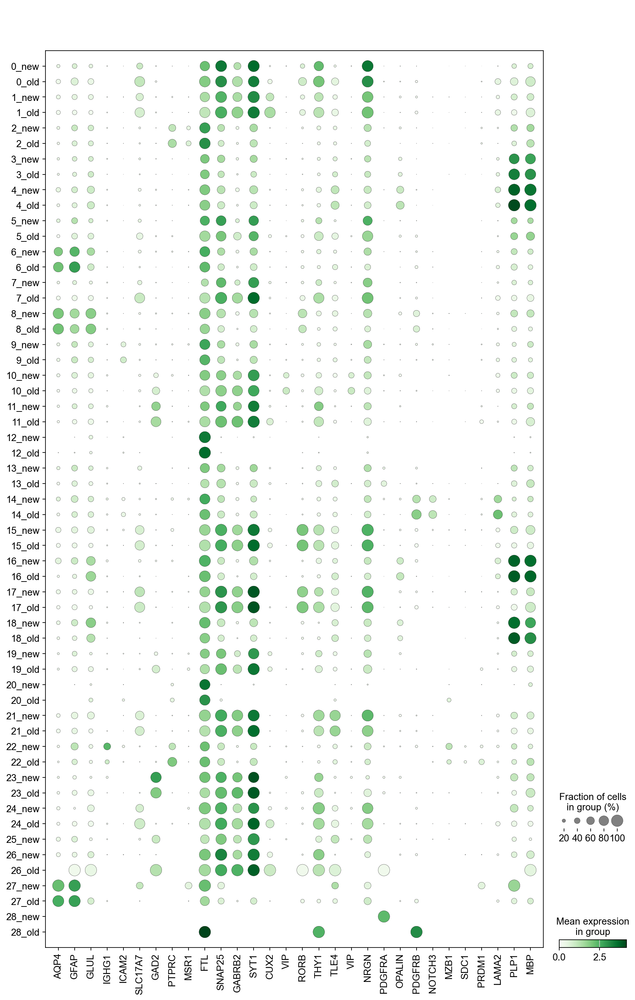

In [137]:
sc.pl.dotplot(adata_donor_assigned_no_doublets, marker_genes, color_map='Greens', save="new_old.png", groupby='leiden_new_old')

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


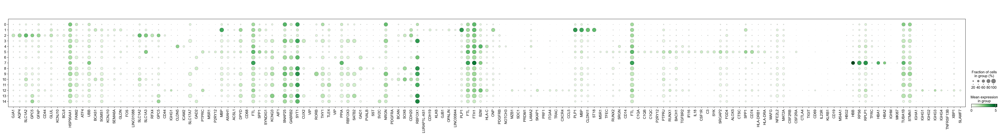

In [138]:
sc.pl.dotplot(adata_donor_assigned_no_doublets, ['GJA1', 'AQP4', 'SLC1A2', 'GPC5', 'GFAP',
'CD44', 'GLUL', 'KCNJ10', 'BCL6', 'HSP90AA1',
'FAIM2', 'ATF4', 'UBB', 'BCAS1', 'SGMS1',
'KCNJ10', 'SEMA6A', 'GLDN', 'FOS', 'LINC01088',
'SLC1A2', 'SLC1A3', 'RFX4', 'GPC5', 'CD44',
'IGHG1', 'CLDN5', 'ICAM2', 'SLC17A7', 'GAD2',
'PTPRC', 'MSR1', 'P2RY12', 'MBP', 'ASAH1',
'ACSL1', 'DPYD', 'CD68', 'FTL', 'SPP1',
'SYNDIG1', 'KCNQ3', 'AIF1', 'SNAP25', 'GABRB2',
'SYT1', 'CUX2', 'VIP', 'RORB', 'THY1',
'TLE4', 'VIP', 'PPIA', 'RBFOX3', 'SATB2',
'GAD1', 'PVALB', 'SST', 'SV2C', 'NRGN',
'PDGFRA', 'BCAN', 'SOX6', 'CDH20', 'RBFOX1',
'LURAP1L-AS1', 'CDH19', 'KLK6', 'GJB1', 'OPALIN',
'LINC00844', 'PLP1',
'FTL', 'FTH1', 'B2M', 'HLA-C', 'CNP',
'PDGFRB', 'NOTCH3', 'MZB1', 'SDC1', 'PRDM1',
'LAMA2', 'SKAP1', 'PRF1', 'ITGA4', 'TRAC',
'CXCR4', 'CCL5', 'PLP1', 'MBP', 'CLDN11',
'ST18', 'MSR1', 'TFEC', 'RUNX2', 'SRGN',
'CD14', 'FTL', 'C1QA', 'C1QB', 'C1QC',
'P2RY12', 'PTPRJ', 'RUNX1', 'BACH1',
'TGFBR2', 'IFI16', 'IL18', 'CSF1R', 'C3',
'SYK', 'SRGAP2', 'FGD4', 'ALOX5',
'CTSC', 'SPP1', 'CD74', 'HLA-DRB1',
'HLA-DRA', 'MAFG', 'NFE2L2',
'MAT2A', 'CSF2RB', 'CSF2RA', 'CTLA4',
'TIGIT', 'CD69', 'IL23R', 'KLRB1',
'CD19', 'MS4A1', 'HBG2', 'HBB', 'RPS6',
'RPLP1', 'TFRC', 'HBA1', 'HBA2', 'IGHM',
'MKI67', 'TUBA1B', 'STMN1', 'IGHA1', 'IGHG1',
'IGHG2', 'IGHG3', 'IGHG4', 'TNFRSF13B', 'XBP1', 'SLAMF7']

                                                , color_map='Greens', groupby='leiden_res0_25')

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


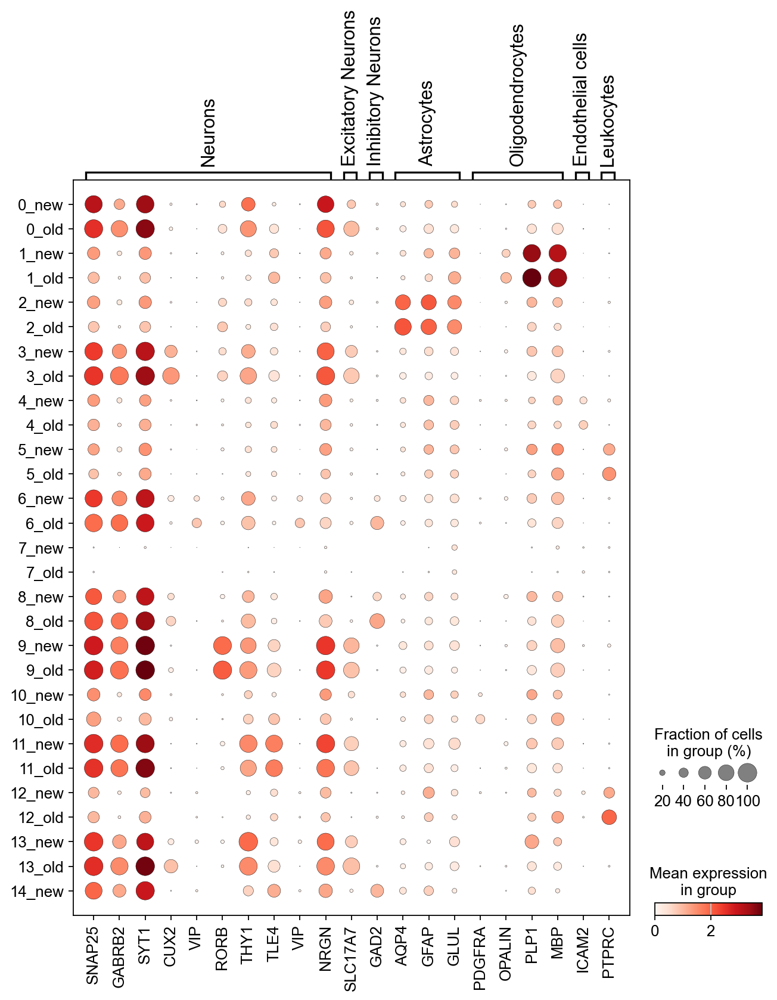

In [139]:
marker_genes_dict = {
    'Neurons': ["SNAP25", "GABRB2", "SYT1", "CUX2", "VIP", "RORB", "THY1", "TLE4", "VIP", "NRGN"],
    'Excitatory Neurons': ['SLC17A7'],
    'Inhibitory Neurons': ['GAD2'],
    'Astrocytes': ["AQP4", "GFAP", "GLUL"],
    'Oligodendrocytes': ["PDGFRA", "OPALIN", "PLP1", "MBP"],
    'Endothelial cells': "ICAM2",
    'Leukocytes': "PTPRC"
}
sc.pl.dotplot(adata_donor_assigned_no_doublets, marker_genes_dict,groupby='leiden_res0_25_new_old')

Looking at the different doublet scores and n_genes to figure out differences as seen in the violin plot above.

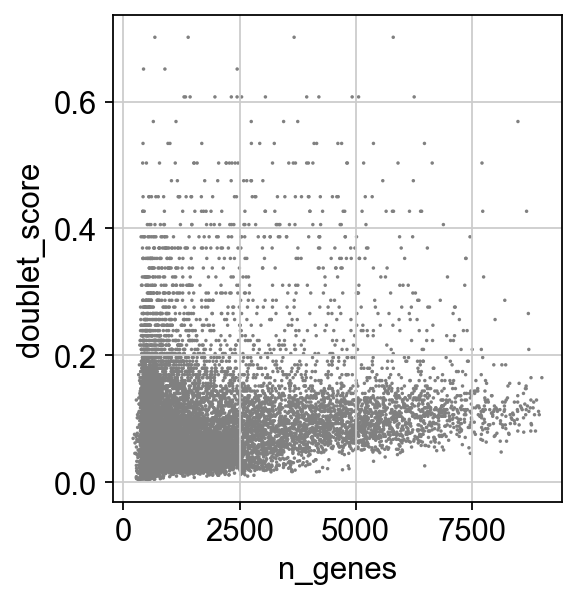

In [140]:
sc.pl.scatter(adata, x='n_genes', y='doublet_score')

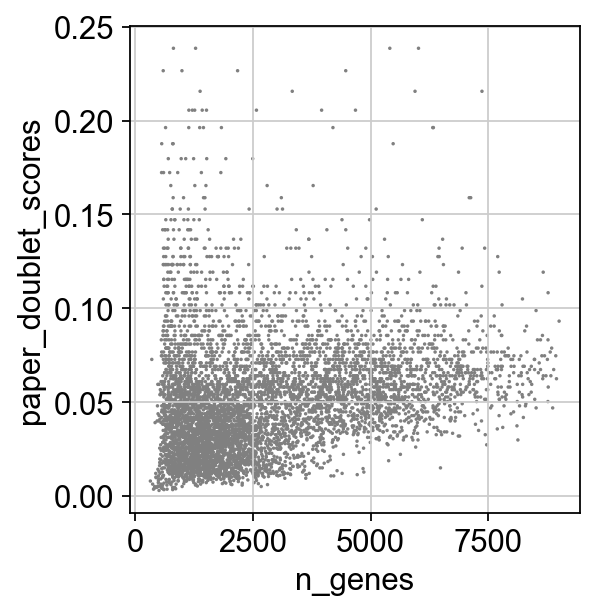

In [141]:
sc.pl.scatter(adata, x='n_genes', y='paper_doublet_scores')

In [142]:
adata.var

,gene_ids,feature_types,n_cells,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm,mean,std
SAMD11,ENSG00000187634,Gene Expression,87,False,87,0.007815,99.339909,103.0,True,0.028683,2.181872,0.821740,3.348740e-11,0.128616
NOC2L,ENSG00000188976,Gene Expression,1331,False,1331,0.122989,89.901366,1621.0,True,0.255346,2.026462,0.574834,1.276848e-10,0.387230
HES4,ENSG00000188290,Gene Expression,1271,False,1271,0.170030,90.356601,2241.0,True,0.379075,2.574380,1.606207,-1.466169e-11,0.476017
ISG15,ENSG00000187608,Gene Expression,871,False,871,0.084143,93.391502,1109.0,True,0.297245,2.543751,1.396674,6.021219e-11,0.421724
TNFRSF18,ENSG00000186891,Gene Expression,88,False,88,0.007132,99.332322,94.0,True,0.027474,2.588907,1.468416,-4.898683e-11,0.119437
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S100B,ENSG00000160307,Gene Expression,3383,False,3383,0.425493,74.332322,5608.0,True,1.015750,2.646245,0.618755,3.130404e-11,0.849703
MT-ATP8,ENSG00000228253,Gene Expression,744,True,744,0.063126,94.355083,832.0,True,0.168494,2.270370,0.962342,-1.042354e-10,0.311254
MT-ND6,ENSG00000198695,Gene Expression,1267,True,1267,0.121927,90.386950,1607.0,True,0.288385,2.289841,0.993275,-6.718031e-11,0.411708
AC007325.4,ENSG00000278817,Gene Expression,619,False,619,0.051669,95.303490,681.0,True,0.131293,2.174702,0.810350,3.436333e-11,0.272645


In [143]:
adata.obs

,donor_identity,donor_id,cluster_label,lowres_cluster_label,sample_id,bucket,disorder,paper_doublet_scores,paper_predicted_doublets,doublet_score,...,pct_counts_mt,leiden,leiden_res0_25,leiden_res0_5,leiden_res1,leiden_res2,doublet_classification_pipeline,newold,leiden_new_old,leiden_res0_25_new_old
Barcode,,,,,,,,,,,,,,,,,,,,,
AAACCCAAGGATGAGA-1,Hash454-TotalSeqA,donor0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.169576,...,6.420546,5,0,1,5,7,no doublet,new,5_new,0_new
AAACCCAAGGTACCTT-1,negative,unassigned,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.043624,...,4.255319,2,5,6,2,1,no doublet,new,2_new,5_new
AAACCCAAGTCATTGC-1,Hash454-TotalSeqA,donor0,OG - OPALINlow_SLC5A11low_RBFOXlow,OG - OPALINlow_SLC5A11low_RBFOXlow,761433_GX38,oligodendrocytes,ms,0.152860,False,0.216216,...,1.270772,3,1,0,3,3,no doublet,old,3_old,1_old
AAACCCAAGTTGGAGC-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.129630,...,2.990342,8,2,2,8,8,no doublet,new,8_new,2_new
AAACCCACAAGGCTTT-1,Hash453-TotalSeqA,donor3,SmoothMusc-ACTA2hi_CNN1pos,Endo,761433_GX38,endothelial,ms,0.090532,False,0.155920,...,4.799302,14,4,4,14,23,no doublet,old,14_old,4_old
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCCACTTTA-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.123260,...,9.997077,6,0,1,6,31,no doublet,new,6_new,0_new
TTTGTTGTCCCTCTAG-1,Hash455-TotalSeqA,donor1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.050929,...,0.115163,12,7,10,12,11,no doublet,new,12_new,7_new
TTTGTTGTCCGTACGG-1,Hash456-TotalSeqA,donor5,OG - OPALINhi_PLXDC2hi,OG - OPALINhi_PLXDC2hi,761433_GX38,oligodendrocytes,ms,0.033449,False,0.058073,...,0.332311,4,1,0,4,2,no doublet,old,4_old,1_old


In [144]:
print(adata.obs.keys())

Index(['donor_identity', 'donor_id', 'cluster_label', 'lowres_cluster_label',
       'sample_id', 'bucket', 'disorder', 'paper_doublet_scores',
       'paper_predicted_doublets', 'doublet_score', 'n_genes',
       'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt',
       'leiden', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1',
       'leiden_res2', 'doublet_classification_pipeline', 'newold',
       'leiden_new_old', 'leiden_res0_25_new_old'],
      dtype='object')


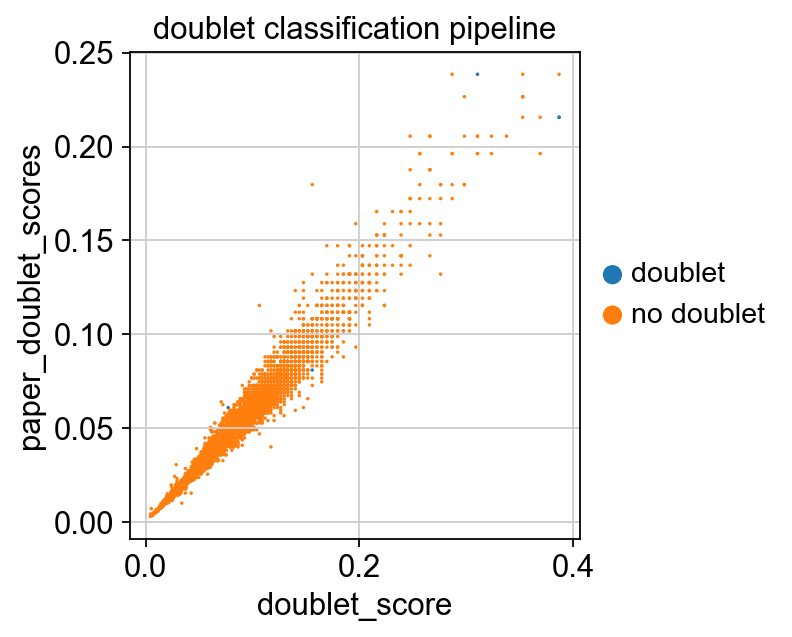

In [145]:
sc.pl.scatter(adata, x='doublet_score', y='paper_doublet_scores', color='doublet_classification_pipeline')

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


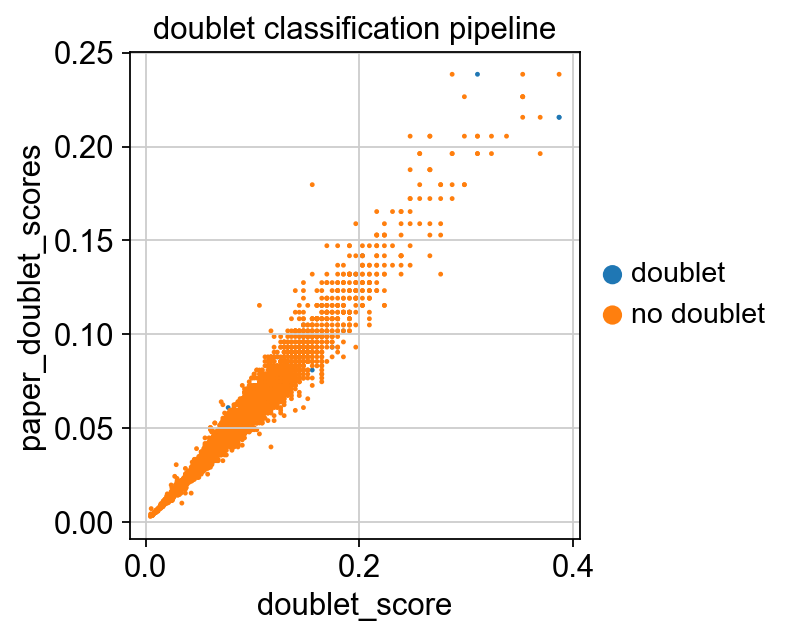

In [146]:
sc.pl.scatter(adata_old, x='doublet_score', y='paper_doublet_scores', color='doublet_classification_pipeline')

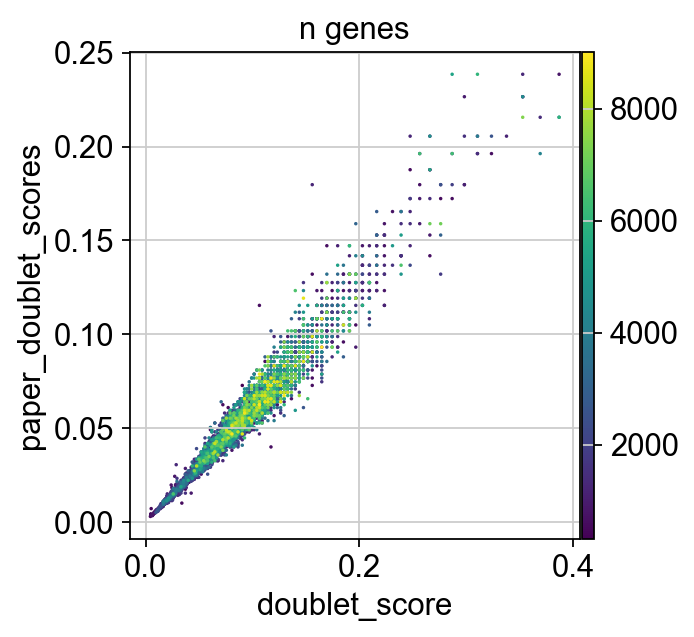

In [147]:
sc.pl.scatter(adata, x='doublet_score', y='paper_doublet_scores', color='n_genes')

In [149]:
adata.obs['paper_predicted_doublets'] = adata.obs['paper_predicted_doublets'].astype(str)
adata.write_h5ad('anndata_post_QC_ms_data_analysis_lennard_gx38_with_hashing_info.h5ad')

/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/lh/opt/anaconda3/envs/DE/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


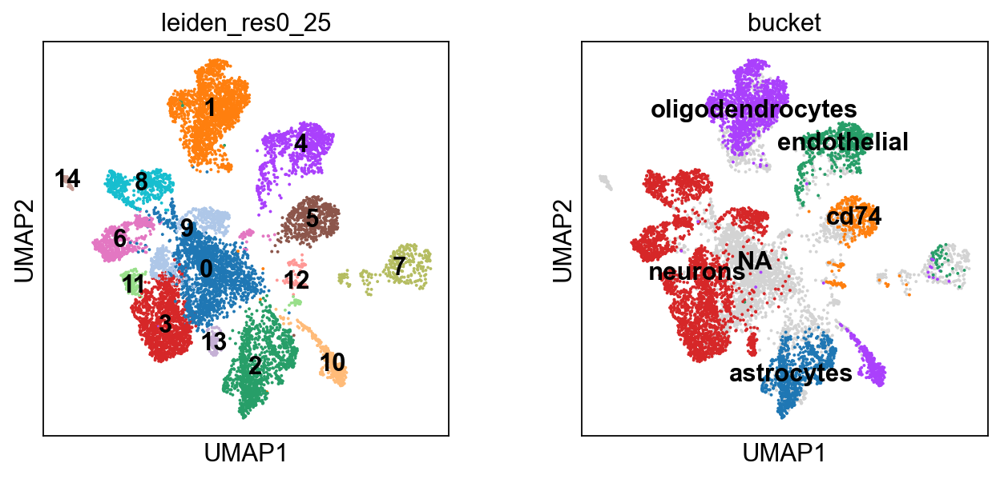

In [150]:
sc.pl.umap(
    adata_donor_assigned_no_doublets,
    color=["leiden_res0_25", "bucket"],
    legend_loc="on data",
)

In [151]:
adata_donor_assigned_no_doublets.obs

,donor_identity,donor_id,cluster_label,lowres_cluster_label,sample_id,bucket,disorder,paper_doublet_scores,paper_predicted_doublets,doublet_score,...,pct_counts_mt,leiden,leiden_res0_25,leiden_res0_5,leiden_res1,leiden_res2,doublet_classification_pipeline,newold,leiden_new_old,leiden_res0_25_new_old
Barcode,,,,,,,,,,,,,,,,,,,,,
AAACCCAAGGATGAGA-1,Hash454-TotalSeqA,donor0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.169576,...,6.420546,5,0,1,5,7,no doublet,new,5_new,0_new
AAACCCAAGTCATTGC-1,Hash454-TotalSeqA,donor0,OG - OPALINlow_SLC5A11low_RBFOXlow,OG - OPALINlow_SLC5A11low_RBFOXlow,761433_GX38,oligodendrocytes,ms,0.152860,False,0.216216,...,1.270772,3,1,0,3,3,no doublet,old,3_old,1_old
AAACCCAAGTTGGAGC-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.129630,...,2.990342,8,2,2,8,8,no doublet,new,8_new,2_new
AAACCCACAAGGCTTT-1,Hash453-TotalSeqA,donor3,SmoothMusc-ACTA2hi_CNN1pos,Endo,761433_GX38,endothelial,ms,0.090532,False,0.155920,...,4.799302,14,4,4,14,23,no doublet,old,14_old,4_old
AAACCCACACACAGCC-1,Hash453-TotalSeqA,donor3,CUX2_PALMDpos_FREM3pos,CUX2,761433_GX38,neurons,ms,0.041888,False,0.064777,...,0.459821,1,3,3,1,21,no doublet,old,1_old,3_old
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCCACTTTA-1,Hash453-TotalSeqA,donor3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.123260,...,9.997077,6,0,1,6,31,no doublet,new,6_new,0_new
TTTGTTGTCCCTCTAG-1,Hash455-TotalSeqA,donor1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.050929,...,0.115163,12,7,10,12,11,no doublet,new,12_new,7_new
TTTGTTGTCCGTACGG-1,Hash456-TotalSeqA,donor5,OG - OPALINhi_PLXDC2hi,OG - OPALINhi_PLXDC2hi,761433_GX38,oligodendrocytes,ms,0.033449,False,0.058073,...,0.332311,4,1,0,4,2,no doublet,old,4_old,1_old


In [152]:
cell_counts = adata_donor_assigned_no_doublets.obs.groupby(["leiden_res0_25", "newold"]).size().reset_index(name="count")
cell_counts

,leiden_res0_25,newold,count
0,0,new,1591
1,0,old,213
2,1,new,473
3,1,old,1280
4,2,new,325
5,2,old,775
6,3,new,235
7,3,old,1044
8,4,new,146
9,4,old,601


In [153]:
cell_counts_pivot = cell_counts.pivot(index="leiden_res0_25", columns="newold", values="count")
cell_counts_pivot

newold,new,old
leiden_res0_25,,
0,1591,213
1,473,1280
2,325,775
3,235,1044
4,146,601
5,238,309
6,78,490
7,217,57
8,40,445


In [154]:
cell_counts_pivot["new_ratio"] = cell_counts_pivot["new"] / (cell_counts_pivot["new"] + cell_counts_pivot["old"])
cell_counts_pivot

newold,new,old,new_ratio
leiden_res0_25,,,
0,1591,213,0.881929
1,473,1280,0.269823
2,325,775,0.295455
3,235,1044,0.183737
4,146,601,0.195448
5,238,309,0.435101
6,78,490,0.137324
7,217,57,0.791971
8,40,445,0.082474


In [155]:
new_ratio_df = cell_counts_pivot[["new_ratio"]].reset_index()

In [156]:
new_ratio_df

newold,leiden_res0_25,new_ratio
0,0,0.881929
1,1,0.269823
2,2,0.295455
3,3,0.183737
4,4,0.195448
5,5,0.435101
6,6,0.137324
7,7,0.791971
8,8,0.082474
9,9,0.118236


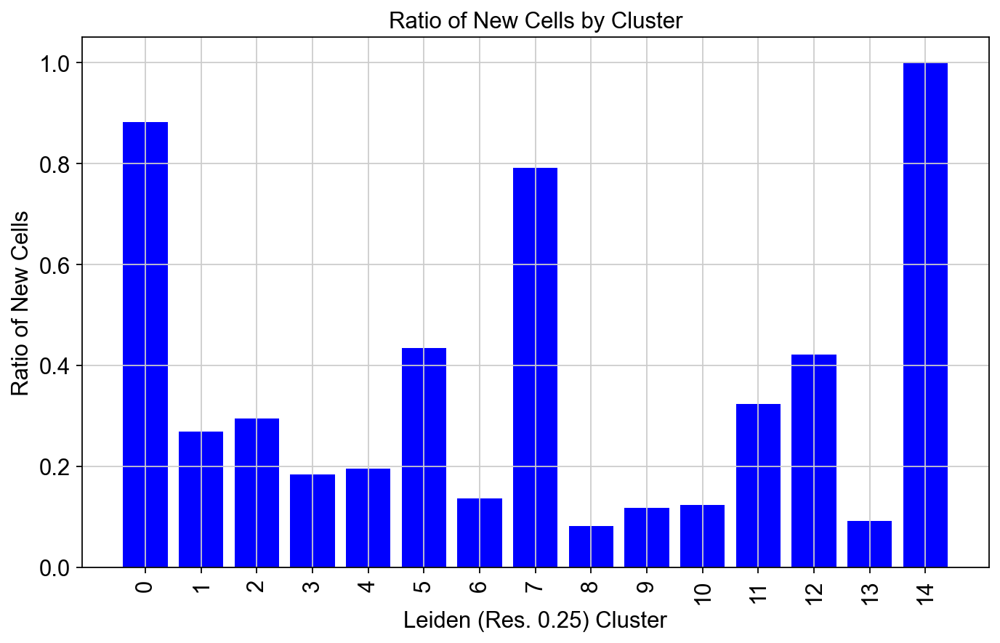

In [157]:
import matplotlib.pyplot as plt

# Set the figure size
plt.figure(figsize=(10, 6))

# Create the bar plot
plt.bar(x=new_ratio_df["leiden_res0_25"], height=new_ratio_df["new_ratio"], color="blue")

# Set the title and axis labels
plt.title("Ratio of New Cells by Cluster")
plt.xlabel("Leiden (Res. 0.25) Cluster")
plt.ylabel("Ratio of New Cells")

# Rotate the x-axis labels if needed
plt.xticks(rotation=90)

# Display the plot
plt.show()

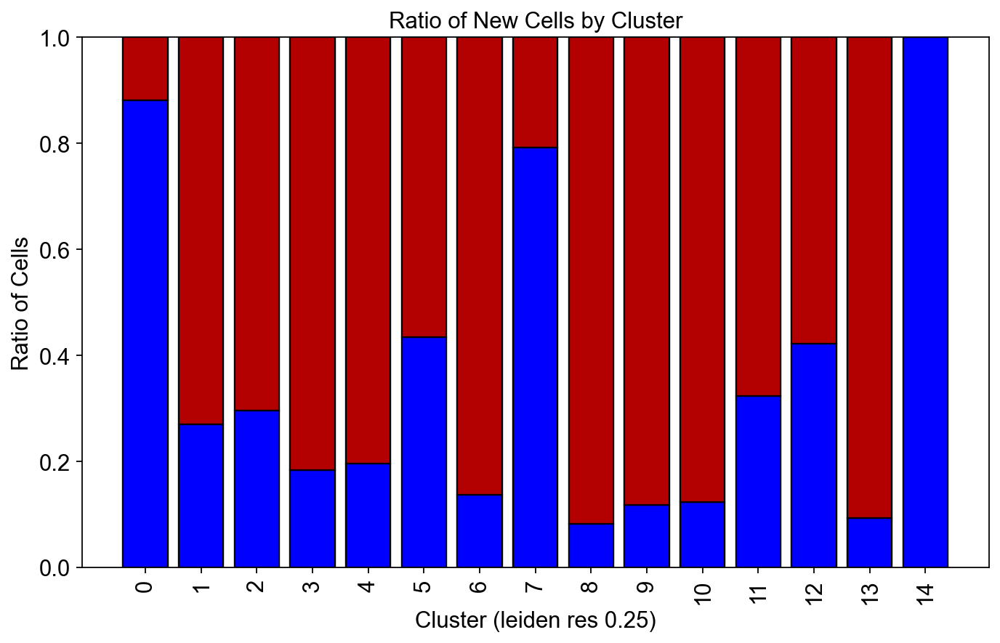

In [161]:
import matplotlib.pyplot as plt

# Set the figure size
plt.figure(figsize=(10, 6))

# Define the colors for the bar plot
colors = ["blue", "red"]

# Create the bar plot
plt.bar(x=new_ratio_df["leiden_res0_25"], height=1, color="#7a7a7a", edgecolor="black")
plt.bar(x=new_ratio_df["leiden_res0_25"], height=new_ratio_df["new_ratio"], color=colors[0], edgecolor="black")

# Set the color of the remaining part of each bar
bottom = new_ratio_df["new_ratio"]
plt.bar(x=new_ratio_df["leiden_res0_25"], height=1-new_ratio_df["new_ratio"], bottom=bottom, color="#b30000", edgecolor="black")

# Set the title and axis labels
plt.title("Ratio of New Cells by Cluster")
plt.xlabel("Cluster (leiden res 0.25)")
plt.ylabel("Ratio of Cells")

# Rotate the x-axis labels if needed
plt.xticks(rotation=90)

plt.grid(False)
# Display the plot
plt.show()

In [159]:
# Get the most prevalent cell type in each cluster
most_prevalent_cell_type = adata.obs.groupby("leiden_res0_25")["bucket"].agg(lambda x:x.value_counts().index[0]).reset_index()
most_prevalent_cell_type.columns = ["leiden_res0_25", "most_prevalent_cell_type"]

# Merge the most_prevalent_cell_type dataframe with the new_ratio_df dataframe
new_ratio_df_merged = new_ratio_df.merge(most_prevalent_cell_type, on="leiden_res0_25")

# Sort the merged dataframe based on most_prevalent_cell_type and cluster
new_ratio_df_sorted = new_ratio_df_merged.sort_values(by=["most_prevalent_cell_type", "leiden_res0_25"])

# Print the sorted dataframe
new_ratio_df_sorted

,leiden_res0_25,new_ratio,most_prevalent_cell_type
2,2,0.295455,astrocytes
14,14,1.000000,astrocytes
5,5,0.435101,cd74
12,12,0.421687,cd74
4,4,0.195448,endothelial
7,7,0.791971,endothelial
0,0,0.881929,neurons
3,3,0.183737,neurons
6,6,0.137324,neurons
8,8,0.082474,neurons
